# Temperature Forecast Project using ML

#### Project Description
This data is for the purpose of bias correction of next-day maximum and minimum air temperatures forecast of the LDAPS model operated by the Korea Meteorological Administration over Seoul, South Korea. This data consists of summer data from 2013 to 2017. The input data is largely composed of the LDAPS model's next-day forecast data, in-situ maximum and minimum temperatures of present-day, and geographic auxiliary variables. There are two outputs (i.e. next-day maximum and minimum air temperatures) in this data. Hindcast validation was conducted for the period from 2015 to 2017.

#### Attribute Information:
For more information, read [Cho et al, 2020].
1. station - used weather station number: 1 to 25
2. Date - Present day: yyyy-mm-dd ('2013-06-30' to '2017-08-30')
3. Present_Tmax - Maximum air temperature between 0 and 21 h on the present day (Â°C): 20 to 37.6
4. Present_Tmin - Minimum air temperature between 0 and 21 h on the present day (Â°C): 11.3 to 29.9
5. LDAPS_RHmin - LDAPS model forecast of next-day minimum relative humidity (%): 19.8 to 98.5
6. LDAPS_RHmax - LDAPS model forecast of next-day maximum relative humidity (%): 58.9 to 100
7. LDAPS_Tmax_lapse - LDAPS model forecast of next-day maximum air temperature applied lapse rate (Â°C): 17.6 to 38.5
8. LDAPS_Tmin_lapse - LDAPS model forecast of next-day minimum air temperature applied lapse rate (Â°C): 14.3 to 29.6
9. LDAPS_WS - LDAPS model forecast of next-day average wind speed (m/s): 2.9 to 21.9
10. LDAPS_LH - LDAPS model forecast of next-day average latent heat flux (W/m2): -13.6 to 213.4
11. LDAPS_CC1 - LDAPS model forecast of next-day 1st 6-hour split average cloud cover (0-5 h) (%): 0 to 0.97
12. LDAPS_CC2 - LDAPS model forecast of next-day 2nd 6-hour split average cloud cover (6-11 h) (%): 0 to 0.97
13. LDAPS_CC3 - LDAPS model forecast of next-day 3rd 6-hour split average cloud cover (12-17 h) (%): 0 to 0.98
14. LDAPS_CC4 - LDAPS model forecast of next-day 4th 6-hour split average cloud cover (18-23 h) (%): 0 to 0.97
15. LDAPS_PPT1 - LDAPS model forecast of next-day 1st 6-hour split average precipitation (0-5 h) (%): 0 to 23.7
16. LDAPS_PPT2 - LDAPS model forecast of next-day 2nd 6-hour split average precipitation (6-11 h) (%): 0 to 21.6
17. LDAPS_PPT3 - LDAPS model forecast of next-day 3rd 6-hour split average precipitation (12-17 h) (%): 0 to 15.8
18. LDAPS_PPT4 - LDAPS model forecast of next-day 4th 6-hour split average precipitation (18-23 h) (%): 0 to 16.7
19. lat - Latitude (Â°): 37.456 to 37.645
20. lon - Longitude (Â°): 126.826 to 127.135
21. DEM - Elevation (m): 12.4 to 212.3
22. Slope - Slope (Â°): 0.1 to 5.2
23. Solar radiation - Daily incoming solar radiation (wh/m2): 4329.5 to 5992.9
24. Next_Tmax - The next-day maximum air temperature (Â°C): 17.4 to 38.9
25. Next_Tmin - The next-day minimum air temperature (Â°C): 11.3 to 29.8T

#### You have to build separate models that can predict the minimum temperature for the next day and the maximum temperature for the next day based on the details provided in the dataset.

- Dataset Link-
•	https://github.com/FlipRoboTechnologies/ML_-Datasets/blob/main/Temperature%20Forecast/temperature.csv


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [2]:
'''IMPORTING THE LIBRARIES
EPLORATORY DATA ANALYSIS
do non graphical analysis
ghraphical analysis
    univariate analysis
    bivariate analysis
    multivaraiate analysis
check outliers and remove if present
check multicollinearity
remove multicollinearity if present
apply feature scaling methods on numerical features
apply resampling methods to balance the classes
split the dataset into features and target variable and then train data and test dataset by using train_test_split() method
Model Building
Cross Validation Score
Finalizing the Model
Predicting the saved Model'''

'IMPORTING THE LIBRARIES\nEPLORATORY DATA ANALYSIS\ndo non graphical analysis\nghraphical analysis\n    univariate analysis\n    bivariate analysis\n    multivaraiate analysis\ncheck outliers and remove if present\ncheck multicollinearity\nremove multicollinearity if present\napply feature scaling methods on numerical features\napply resampling methods to balance the classes\nsplit the dataset into features and target variable and then train data and test dataset by using train_test_split() method\nModel Building\nCross Validation Score\nFinalizing the Model\nPredicting the saved Model'

In [3]:
df=pd.read_csv('https://raw.githubusercontent.com/FlipRoboTechnologies/ML_-Datasets/main/Temperature%20Forecast/temperature.csv')
df

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.000000,0.000000,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.000000,0.000000,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.000000,0.000000,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.000000,0.000000,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,30-08-2017,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1
7748,24.0,30-08-2017,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,30-08-2017,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3


In total we have 7752  rows and 25 columns

# Exploratory Data Analysis

In [4]:
df.head()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5


In [5]:
df.tail()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
7747,23.0,30-08-2017,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1
7748,24.0,30-08-2017,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,30-08-2017,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3
7751,NaN,NaN,37.6,29.9,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,...,21.621661,15.841235,16.655469,37.6450,127.135,212.3350,5.178230,5992.895996,38.9,29.8


- It is observed that the data has null values in it and we will have to treat them. 

In [6]:
df.columns

Index(['station', 'Date', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin',
       'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS',
       'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4',
       'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon',
       'DEM', 'Slope', 'Solar radiation', 'Next_Tmax', 'Next_Tmin'],
      dtype='object')

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7752 entries, 0 to 7751
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   station           7750 non-null   float64
 1   Date              7750 non-null   object 
 2   Present_Tmax      7682 non-null   float64
 3   Present_Tmin      7682 non-null   float64
 4   LDAPS_RHmin       7677 non-null   float64
 5   LDAPS_RHmax       7677 non-null   float64
 6   LDAPS_Tmax_lapse  7677 non-null   float64
 7   LDAPS_Tmin_lapse  7677 non-null   float64
 8   LDAPS_WS          7677 non-null   float64
 9   LDAPS_LH          7677 non-null   float64
 10  LDAPS_CC1         7677 non-null   float64
 11  LDAPS_CC2         7677 non-null   float64
 12  LDAPS_CC3         7677 non-null   float64
 13  LDAPS_CC4         7677 non-null   float64
 14  LDAPS_PPT1        7677 non-null   float64
 15  LDAPS_PPT2        7677 non-null   float64
 16  LDAPS_PPT3        7677 non-null   float64


In [8]:
df.isnull().sum()

station              2
Date                 2
Present_Tmax        70
Present_Tmin        70
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax           27
Next_Tmin           27
dtype: int64

- The data has 24 columns with float64 datatype and 1 object datatype. 
- It is very much clear that null values exists in the data provided lets check through heatmap

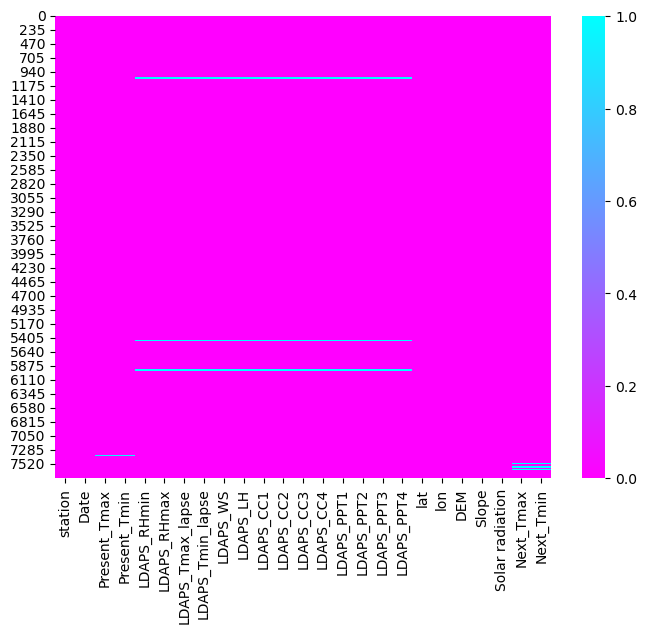

In [9]:
#Missing Value check
plt.figure(figsize = (8,6))
sns.heatmap(df.isnull(),cmap = 'cool_r')
plt.show()

#### From the heatmap we can observe that some of the rows continously donot have values in the entire rows.
- We have two options either to fill the missing data by mean or median or delete the rows with null values
- As there is continous value missing in the entire rows we can delete rows. If we replace them with mean/median values they wwill only be predicted figures but entire rows will not have the real data 

In [10]:
# Checking for null values in the dataset
null_rows = df[df.isnull().any(axis=1)]
# Displaying the rows with null values
print(null_rows)

      station        Date  Present_Tmax  Present_Tmin  LDAPS_RHmin  \
225       1.0  09-07-2013           NaN           NaN    70.051193   
271      22.0  10-07-2013           NaN           NaN    72.196007   
300       1.0  12-07-2013           NaN           NaN    95.027298   
450       1.0  18-07-2013           NaN           NaN    60.891193   
464      15.0  18-07-2013           NaN           NaN    52.795406   
...       ...         ...           ...           ...          ...   
7629      5.0  26-08-2017           NaN           NaN    43.755058   
7682      8.0  28-08-2017          26.3          18.1    29.959215   
7707      8.0  29-08-2017           NaN           NaN    44.392651   
7750      NaN         NaN          20.0          11.3    19.794666   
7751      NaN         NaN          37.6          29.9    98.524734   

      LDAPS_RHmax  LDAPS_Tmax_lapse  LDAPS_Tmin_lapse   LDAPS_WS    LDAPS_LH  \
225     99.668961         27.872808         22.907420  11.017837   44.002020   

- These are the rows having null values in almost all its columns and they can be deleted

In [11]:
# dropping all null values
df=df.dropna()

In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7588 entries, 0 to 7749
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   station           7588 non-null   float64
 1   Date              7588 non-null   object 
 2   Present_Tmax      7588 non-null   float64
 3   Present_Tmin      7588 non-null   float64
 4   LDAPS_RHmin       7588 non-null   float64
 5   LDAPS_RHmax       7588 non-null   float64
 6   LDAPS_Tmax_lapse  7588 non-null   float64
 7   LDAPS_Tmin_lapse  7588 non-null   float64
 8   LDAPS_WS          7588 non-null   float64
 9   LDAPS_LH          7588 non-null   float64
 10  LDAPS_CC1         7588 non-null   float64
 11  LDAPS_CC2         7588 non-null   float64
 12  LDAPS_CC3         7588 non-null   float64
 13  LDAPS_CC4         7588 non-null   float64
 14  LDAPS_PPT1        7588 non-null   float64
 15  LDAPS_PPT2        7588 non-null   float64
 16  LDAPS_PPT3        7588 non-null   float64


- Hense all the 164 rows with null values have been removed and now we are left with 7588 rows out of which we have 24 numerical values and 1 object which is a date column. We will have to convert datatype of date into datatime dataype

<Axes: >

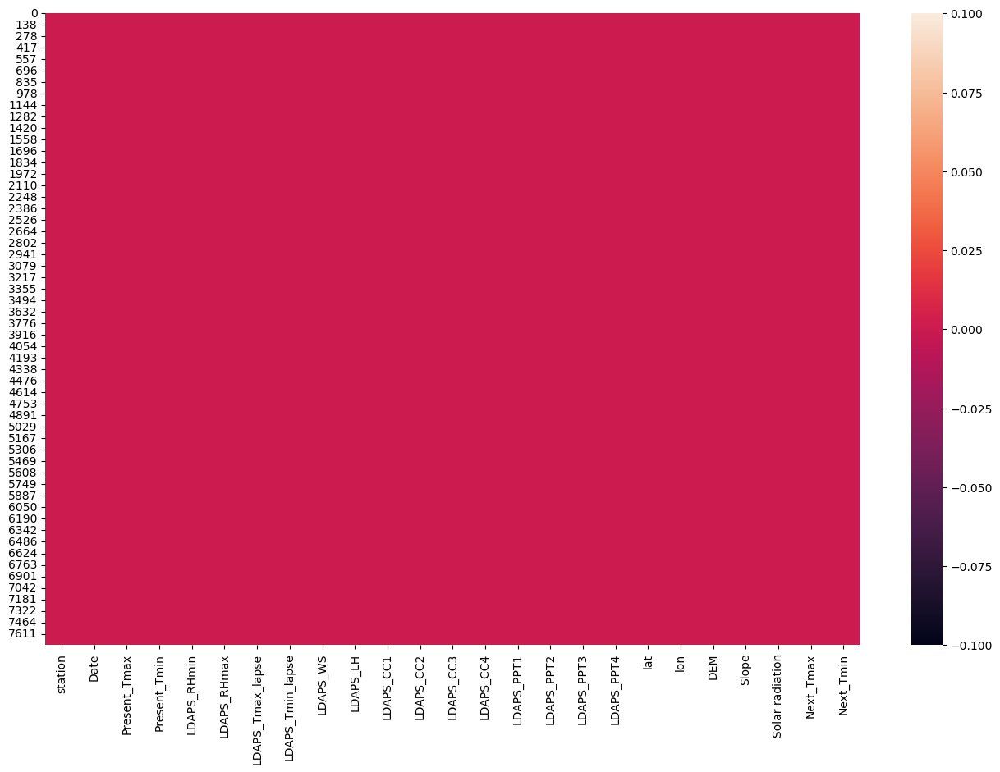

In [13]:
# Lets check with the heatmap again
plt.figure(figsize = (16,10))
sns.heatmap(df.isnull())

- There in no Null value in the data set now. Lets treat date datatype

In [14]:
# Lets convert the datatype of date column from object datatype to datetime datatype
df['Date']=pd.to_datetime(df['Date'])
df.dtypes

station                    float64
Date                datetime64[ns]
Present_Tmax               float64
Present_Tmin               float64
LDAPS_RHmin                float64
LDAPS_RHmax                float64
LDAPS_Tmax_lapse           float64
LDAPS_Tmin_lapse           float64
LDAPS_WS                   float64
LDAPS_LH                   float64
LDAPS_CC1                  float64
LDAPS_CC2                  float64
LDAPS_CC3                  float64
LDAPS_CC4                  float64
LDAPS_PPT1                 float64
LDAPS_PPT2                 float64
LDAPS_PPT3                 float64
LDAPS_PPT4                 float64
lat                        float64
lon                        float64
DEM                        float64
Slope                      float64
Solar radiation            float64
Next_Tmax                  float64
Next_Tmin                  float64
dtype: object

In [15]:
# Now splitting into months and year to make more analysis and study them
# Month
df["Month"]=df["Date"].dt.month
# Year
df["Year"]=df["Date"].dt.year

In [16]:
#Now we can drop the date column from the dataset to avoid duplication.
df.drop("Date", axis=1,inplace=True)

In [17]:
# lets check the dataset head using df.head()
df.head()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Month,Year
0,1.0,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,...,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2,6,2013
1,2.0,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,...,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5,6,2013
2,3.0,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,...,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9,6,2013
3,4.0,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,...,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3,6,2013
4,5.0,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,...,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5,6,2013


In [18]:
# checking the value counts of each column
for i in df.columns:
    print (df[i].value_counts())
    print('\n')

25.0    307
10.0    307
23.0    307
18.0    307
17.0    307
2.0     307
3.0     306
4.0     306
13.0    305
16.0    304
20.0    304
21.0    304
14.0    303
1.0     303
9.0     302
12.0    302
15.0    302
19.0    302
22.0    302
24.0    302
11.0    301
7.0     301
6.0     301
8.0     300
5.0     296
Name: station, dtype: int64


31.4    112
29.4    108
29.1    106
29.2    105
30.6    105
       ... 
21.2      1
20.1      1
36.4      1
20.3      1
20.0      1
Name: Present_Tmax, Length: 167, dtype: int64


24.0    160
23.8    153
23.5    143
23.1    143
23.3    140
       ... 
14.3      1
29.9      1
29.7      1
29.1      1
15.0      1
Name: Present_Tmin, Length: 155, dtype: int64


77.030350    2
51.810596    2
71.658089    2
58.255688    1
46.582764    1
            ..
58.950947    1
58.566174    1
59.790348    1
51.062355    1
22.933014    1
Name: LDAPS_RHmin, Length: 7585, dtype: int64


92.531029    2
88.876610    2
85.863731    2
96.525200    2
96.058418    2
            ..
84.4236

# Descriptive Statistics

In [19]:
df.describe()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Month,Year
count,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,...,7588.000000,7588.000000,7588.00000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000,7588.000000
mean,13.014101,29.748366,23.195809,56.724969,88.360823,29.620128,23.511786,7.094097,62.492606,0.368510,...,0.265373,37.544792,126.99142,61.918136,1.259755,5343.724208,30.241526,22.910820,7.068134,2014.991697
std,7.217858,2.967401,2.400880,14.626559,7.199456,2.943496,2.342579,2.177034,33.686158,0.262260,...,1.179661,0.050428,0.07922,54.323529,1.372748,429.782561,3.111807,2.482256,2.242389,1.410877
min,1.000000,20.000000,11.300000,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,0.000000,...,0.000000,37.456200,126.82600,12.370000,0.098500,4329.520508,17.400000,11.300000,1.000000,2013.000000
25%,7.000000,27.800000,21.600000,45.960243,84.203724,27.673756,22.086820,5.675358,37.206201,0.146546,...,0.000000,37.510200,126.93700,28.700000,0.271300,5001.485717,28.200000,21.300000,7.000000,2014.000000
50%,13.000000,29.900000,23.400000,55.023199,89.784122,29.709537,23.758249,6.547838,56.898324,0.315706,...,0.000000,37.550700,126.99500,45.716000,0.618000,5441.987305,30.400000,23.100000,7.000000,2015.000000
75%,19.000000,32.000000,24.800000,67.115099,93.742725,31.711109,25.155660,8.028960,84.235666,0.574174,...,0.000017,37.577600,127.04200,59.832400,1.767800,5729.485840,32.600000,24.600000,8.000000,2016.000000
max,25.000000,37.600000,29.900000,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,0.967277,...,16.655469,37.645000,127.13500,212.335000,5.178200,5992.895996,38.900000,29.800000,12.000000,2017.000000


### OBSERVATIONS:
- Mean is greater than median(50%) in LDAPS_RHmin, LDAPS_WS, LDAPS_LH, LDAPS_PPT4, DEM, Slope. Hense it is right oir posstively skewed data in these columns.
- Mean is less than median LDAPS_RHmax, Solar radiation, Next_Tmin. It a negatively or left skewed data for these columns.
- In almost all columns it is noticed that there is huge difference between Quartile 3(75%) and Max. Hense outliers are present and we will have to treat them as well. 

# Data Visualization and interpretation

25.0    307
10.0    307
23.0    307
18.0    307
17.0    307
2.0     307
3.0     306
4.0     306
13.0    305
16.0    304
20.0    304
21.0    304
14.0    303
1.0     303
9.0     302
12.0    302
15.0    302
19.0    302
22.0    302
24.0    302
11.0    301
7.0     301
6.0     301
8.0     300
5.0     296
Name: station, dtype: int64


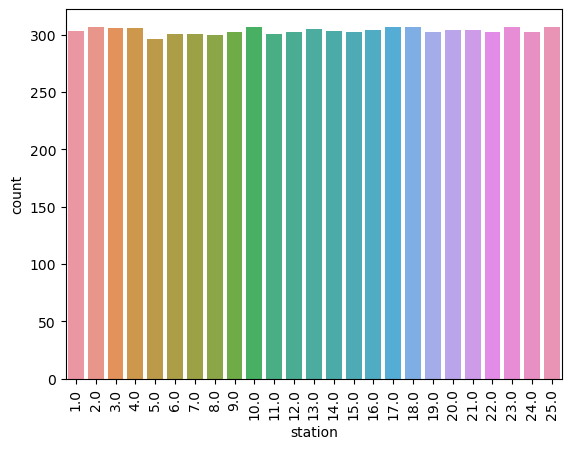

In [20]:
#Univariate Analysis
station  = sns.countplot(x='station',data=df)
# Rotate x-axis labels by 90 degrees
plt.xticks(rotation=90)
print (df['station'].value_counts())

- Almost all the stations have readings in eaqual count of readings

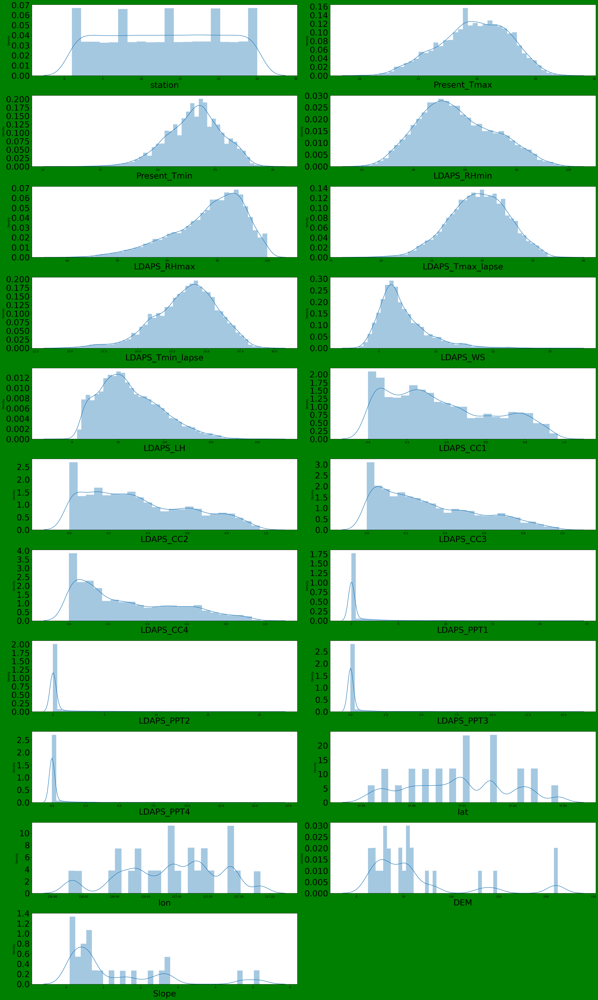

In [21]:
#Finding distribution of data in each column
plt.figure(figsize =(30,50), facecolor = 'green')
plotnumber = 1

for column in df:
    if plotnumber <=21:
        ax = plt.subplot(11,2,plotnumber)
        sns.distplot(df[column])
        plt.xlabel(column,fontsize = 30)
        plt.yticks(rotation=0,fontsize=30)       
    plotnumber +=1
plt.tight_layout()

#### Here's a summary of the distribution of data in various columns of the dataset:

- Station: The data in the 'station' column appears to be normally distributed.
- Present Tmax: The data for 'Present_Tmax' seems to follow a normal distribution with minimal skewness.
- Present Tmin: The 'Present_Tmin' data is has a bell-shaped curve.
- LDAPS_RHmin: This column is slightly skewed to the right, indicating that the mean is higher than the median.
- LDAPS_RHmax: The data here is skewed to the left, meaning the median is higher than the mean.
- LDAPS_CC1, LDAPS_CC2, LDAPS_CC3, LDAPS_CC4: These columns are all slightly right-skewed.
- LDAPS_PPT1, LDAPS_PPT2, LDAPS_PPT3, LDAPS_PPT4: These columns are also skewed to the right.
- Latitude (LAT) and Longitude (LON): The data for these columns appears to be normally distributed but with a high standard deviation, indicating the data is spread out.
- DEM (Elevation) and Slope: Both of these columns are skewed to the right.
- Solar Radiation: This column is skewed to the right.
#### Target Columns:
-Next_Tmax: Appears to be normally distributed.
- Next_Tmin: Also seems to be normally distributed.

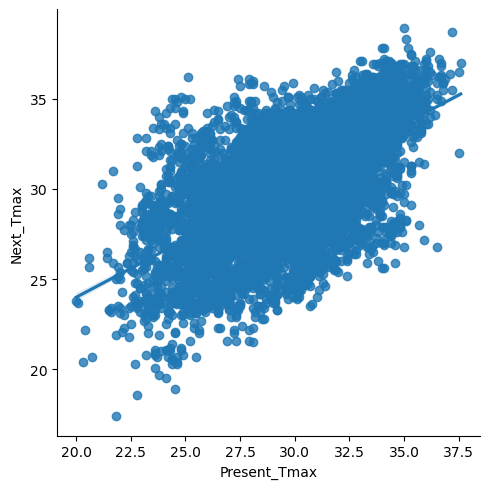

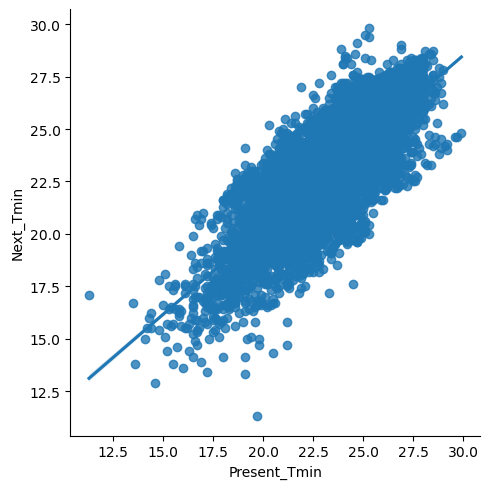

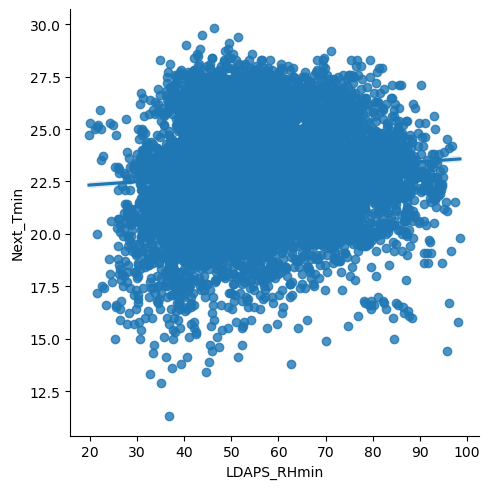

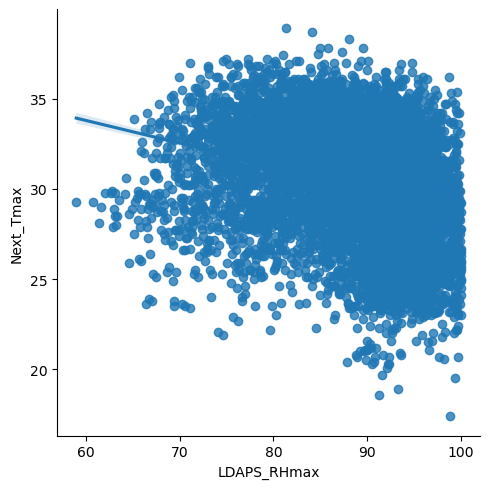

In [22]:
#Bivariate Analysis
sns.lmplot(x='Present_Tmax',y='Next_Tmax',data=df,palette='colorblind')
sns.lmplot(x='Present_Tmin',y='Next_Tmin',data=df,palette='colorblind')
sns.lmplot(x='LDAPS_RHmin',y='Next_Tmin',data=df,palette='colorblind')
sns.lmplot(x='LDAPS_RHmax',y='Next_Tmax',data=df,palette='colorblind')

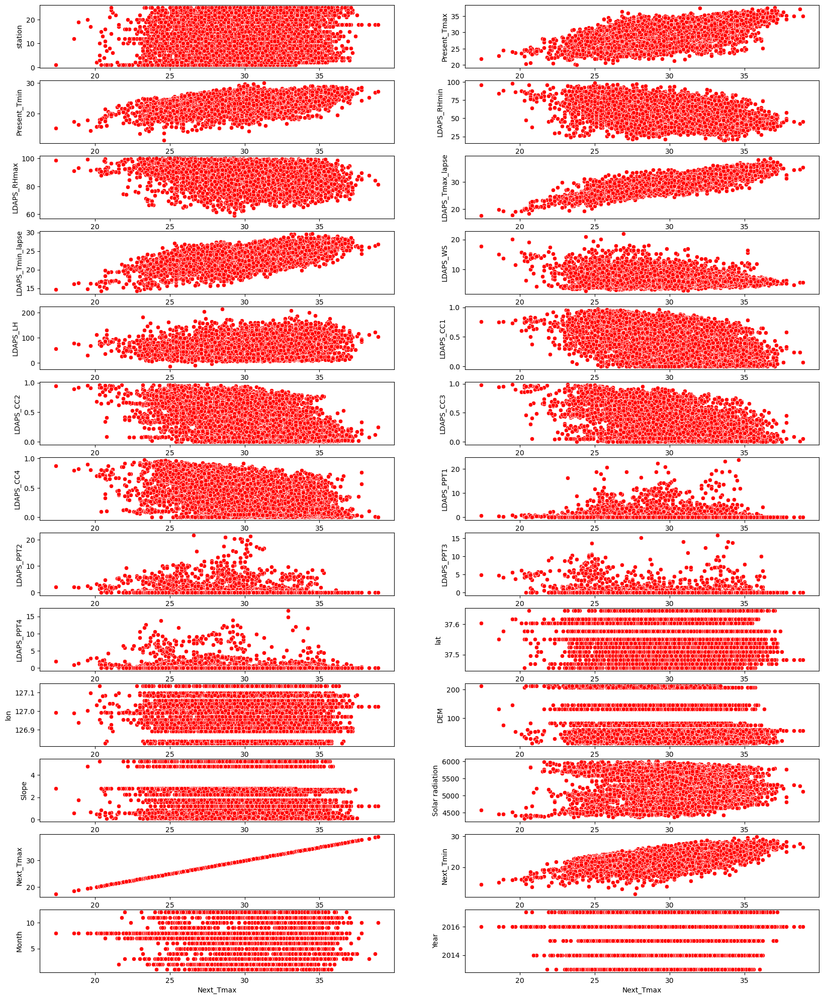

In [23]:
plt.figure(figsize=(20,25))
p=1
for i in df:
    if p<=26:
        plt.subplot(13,2,p)
        sns.scatterplot(x='Next_Tmax',y=i,data=df,color='r')
        plt.xlabel('Next_Tmax')
        plt.ylabel(i)
    p+=1
plt.show()

- Here we can see when Present_Tmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,Next_Tmin is increasing Nex_Tmax is also getting higher.

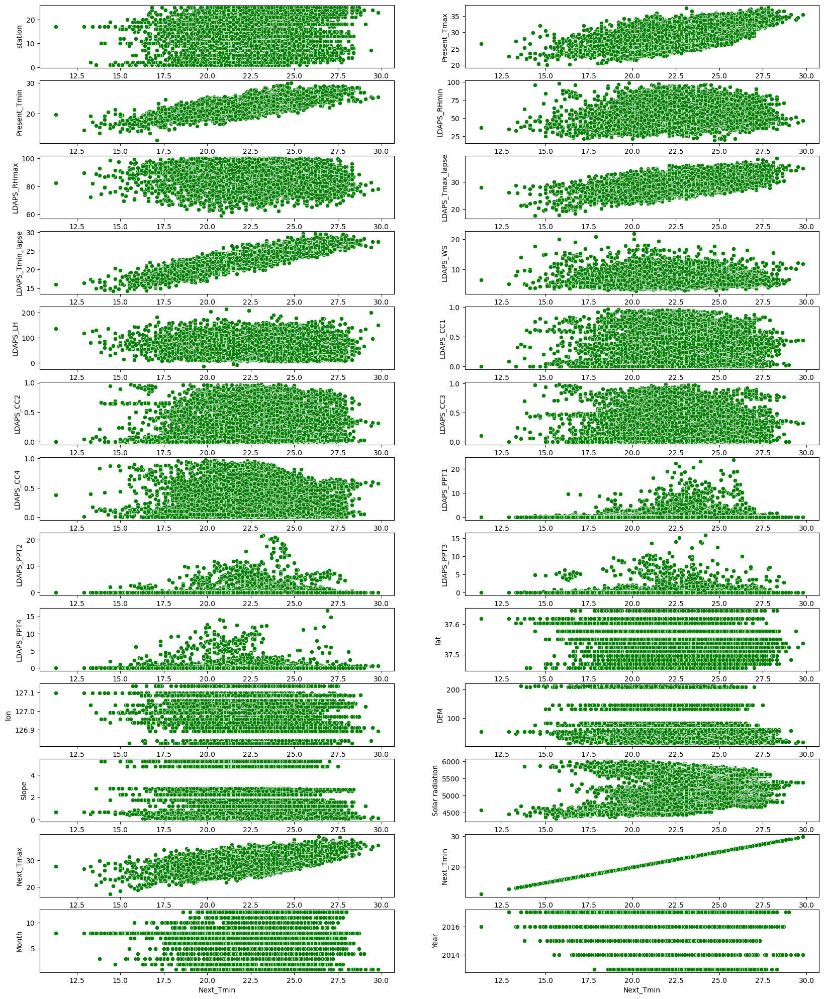

In [24]:
plt.figure(figsize=(20,25))
p=1
for i in df:
    if p<=26:
        plt.subplot(13,2,p)
        sns.scatterplot(x='Next_Tmin',y=i,data=df,color='g')
        plt.xlabel('Next_Tmin')
        plt.ylabel(i)
    p+=1
plt.show()

- Here we can see when Present_Tmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,Next_Tmax  is increasing Nex_Tmin is also getting higher.

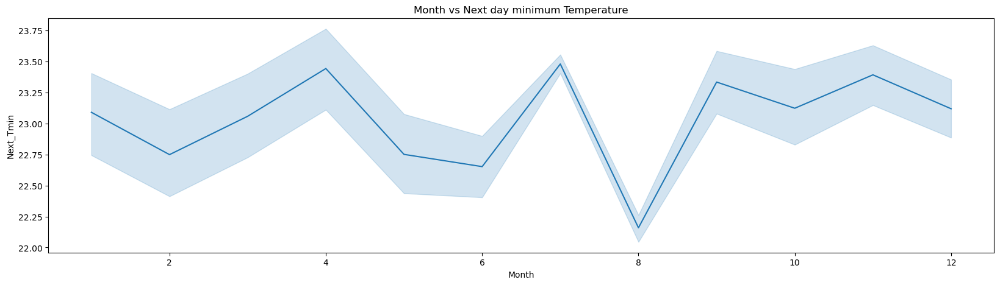

In [25]:
plt.figure(figsize=(20,5))
plt.title('Month vs Next day minimum Temperature')
sns.lineplot(x='Month',y='Next_Tmin',data=df)
plt.show()

- Next_Tmin looks maximum in the month of July and minimum in the month of August

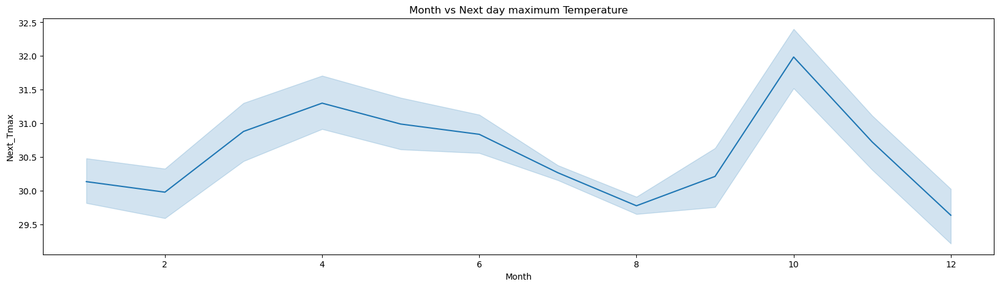

In [26]:
plt.figure(figsize=(20,5))
plt.title('Month vs Next day maximum Temperature')
sns.lineplot(x='Month',y='Next_Tmax',data=df)
plt.show()

- Next_Tmax looks maximum in the month of October and minimum in the month of August.

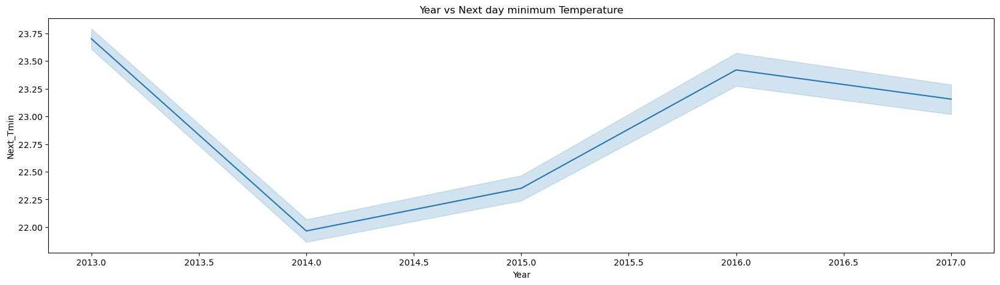

In [27]:
plt.figure(figsize=(20,5))
plt.title('Year vs Next day minimum Temperature')
sns.lineplot(x='Year',y='Next_Tmin',data=df)
plt.show()

- Next_Tmin looks maximum in 2013 and minimum in the 2014

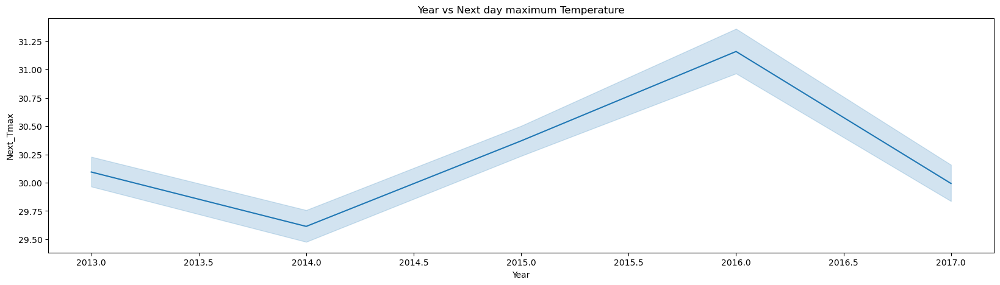

In [28]:
plt.figure(figsize=(20,5))
plt.title('Year vs Next day maximum Temperature')
sns.lineplot(x='Year',y='Next_Tmax',data=df)
plt.show()

- Next_Tmax looks maximum in 2016 and minimum in 2014.

In [31]:
#Multivariate Analysis
cor=df.corr()
cor

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Month,Year
station,1.000000,0.113301,0.133282,-0.067846,-0.169351,0.069856,0.105277,0.005822,-0.132129,0.006539,...,-0.011085,-0.239118,-0.118845,-0.256706,-0.091721,-0.021194,0.107747,0.128184,0.001211,0.001474
Present_Tmax,0.113301,1.000000,0.615208,-0.209059,-0.306943,0.573777,0.628705,-0.125952,0.134246,-0.316333,...,-0.107295,-0.054134,0.007695,-0.189439,-0.107079,-0.022114,0.610357,0.621048,-0.003266,0.056002
Present_Tmin,0.133282,0.615208,1.000000,0.122200,-0.018576,0.467904,0.772061,-0.038779,-0.012817,0.084348,...,-0.070391,-0.081417,-0.045174,-0.254084,-0.148423,0.059765,0.463523,0.796975,-0.010210,0.037457
LDAPS_RHmin,-0.067846,-0.209059,0.122200,1.000000,0.578358,-0.569580,0.085237,0.289422,-0.072195,0.612831,...,0.167311,0.085027,-0.077590,0.100684,0.122454,0.242168,-0.446824,0.093249,-0.053499,-0.002147
LDAPS_RHmax,-0.169351,-0.306943,-0.018576,0.578358,1.000000,-0.377293,-0.118965,0.131269,0.238986,0.435937,...,0.118101,0.194820,0.025563,0.176557,0.219436,0.146622,-0.289788,-0.076415,-0.039424,-0.144286
LDAPS_Tmax_lapse,0.069856,0.573777,0.467904,-0.569580,-0.377293,1.000000,0.653425,-0.316011,0.043663,-0.440878,...,-0.170415,-0.044052,0.091568,-0.181433,-0.163891,0.047414,0.835729,0.589963,-0.022279,0.020308
LDAPS_Tmin_lapse,0.105277,0.628705,0.772061,0.085237,-0.118965,0.653425,1.000000,-0.134652,-0.139675,0.008714,...,-0.103541,-0.099452,-0.024703,-0.198396,-0.187864,0.157763,0.592119,0.886513,-0.027050,-0.000564
LDAPS_WS,0.005822,-0.125952,-0.038779,0.289422,0.131269,-0.316011,-0.134652,1.000000,0.004427,0.285349,...,0.134428,0.033025,-0.063009,0.188540,0.169223,0.120630,-0.351107,-0.102021,-0.082267,-0.114114
LDAPS_LH,-0.132129,0.134246,-0.012817,-0.072195,0.238986,0.043663,-0.139675,0.004427,1.000000,-0.148314,...,0.012372,0.133309,0.024476,0.056362,0.087517,-0.044956,0.156779,-0.060392,-0.024944,0.055898
LDAPS_CC1,0.006539,-0.316333,0.084348,0.612831,0.435937,-0.440878,0.008714,0.285349,-0.148314,1.000000,...,0.088897,-0.010268,-0.007962,-0.017378,-0.023893,0.218285,-0.459705,-0.012877,-0.076819,-0.066233


<Axes: >

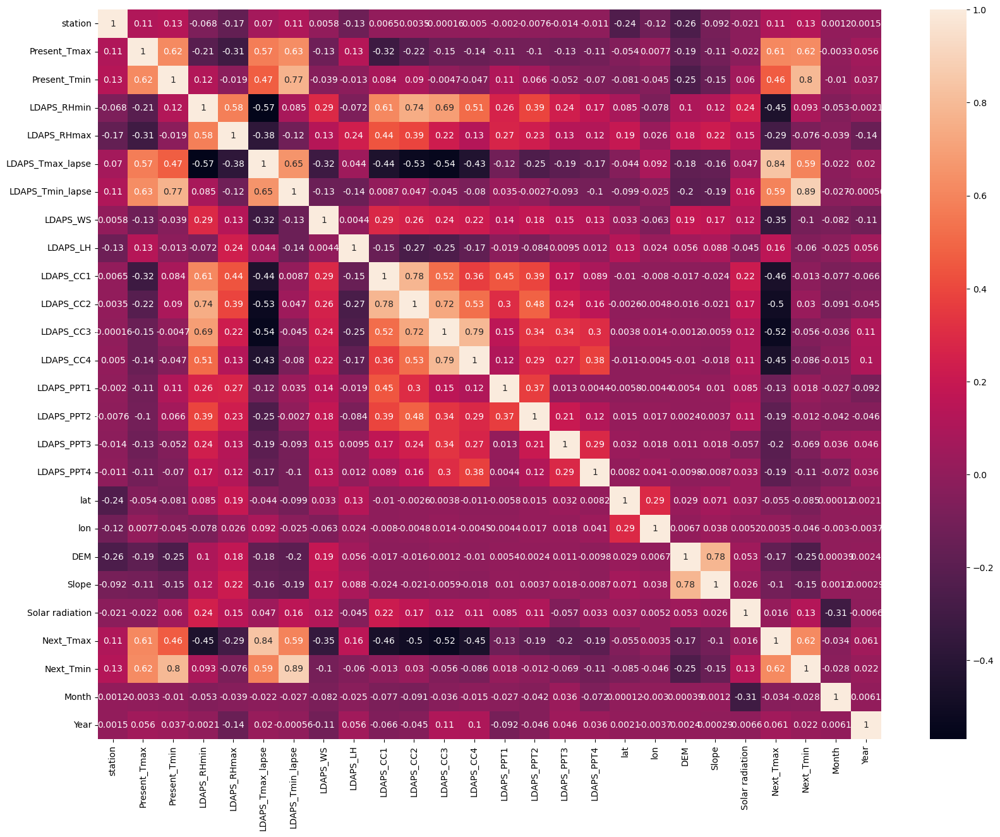

In [33]:
plt.figure(figsize=(20,15))
sns.heatmap(df.corr(),annot=True)

#### Observations:
- We can observe that Present_Tmax and Present_Tmin are correlated with Target variables.
- LDAPS_RHmin and LDAPS_RHmax are also highly correlated with target variables. 
- Next_Tmin and Next_Tmax are also correlated with each other.
- Most of the columns are negatively correlated with target variables.
- LDAPS_cc1,cc2,cc3,cc4 are all correlated to each other. 
- Theres a multicollineearity issues that exists and we will have to treat them. 



In [38]:
#Finding correlation of features wirh the target variables
cor["Next_Tmin"].sort_values(ascending=True)

DEM                -0.249303
Slope              -0.148379
LDAPS_PPT4         -0.114900
LDAPS_WS           -0.102021
LDAPS_CC4          -0.086197
lat                -0.085136
LDAPS_RHmax        -0.076415
LDAPS_PPT3         -0.068664
LDAPS_LH           -0.060392
LDAPS_CC3          -0.056490
lon                -0.045758
Month              -0.028344
LDAPS_CC1          -0.012877
LDAPS_PPT2         -0.012462
LDAPS_PPT1          0.018031
Year                0.021617
LDAPS_CC2           0.030358
LDAPS_RHmin         0.093249
Solar radiation     0.125517
station             0.128184
LDAPS_Tmax_lapse    0.589963
Next_Tmax           0.616629
Present_Tmax        0.621048
Present_Tmin        0.796975
LDAPS_Tmin_lapse    0.886513
Next_Tmin           1.000000
Name: Next_Tmin, dtype: float64

In [39]:
#Finding correlation of features wirh the target variables
cor["Next_Tmax"].sort_values(ascending=True)

LDAPS_CC3          -0.523061
LDAPS_CC2          -0.498295
LDAPS_CC1          -0.459705
LDAPS_CC4          -0.454039
LDAPS_RHmin        -0.446824
LDAPS_WS           -0.351107
LDAPS_RHmax        -0.289788
LDAPS_PPT3         -0.203554
LDAPS_PPT4         -0.190720
LDAPS_PPT2         -0.186722
DEM                -0.174578
LDAPS_PPT1         -0.125954
Slope              -0.104279
lat                -0.055367
Month              -0.033684
lon                 0.003502
Solar radiation     0.016145
Year                0.061211
station             0.107747
LDAPS_LH            0.156779
Present_Tmin        0.463523
LDAPS_Tmin_lapse    0.592119
Present_Tmax        0.610357
Next_Tmin           0.616629
LDAPS_Tmax_lapse    0.835729
Next_Tmax           1.000000
Name: Next_Tmax, dtype: float64

- Both the Target are correlated to LDAPS_Tmax_lapse,Present_Tmax ,LDAPS_Tmin_lapse, Present_Tmin and to each other

# Finding Outliers

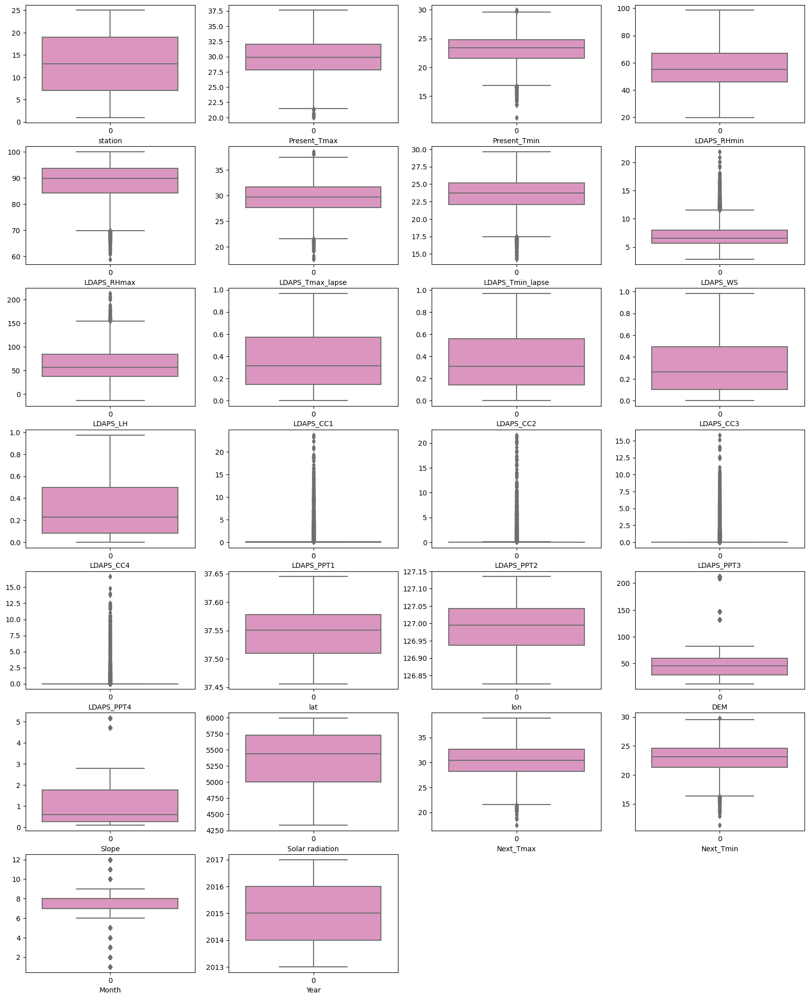

In [37]:
# Lets check the outliersby plotting boxplot.
plt.figure(figsize=(20,25))
p=1
for i in df:
    if p<=26:
        plt.subplot(7,4,p)
        sns.boxplot(df[i], palette = 'Set2_r')
        plt.xlabel(i)
    p+=1
plt.show()

#### Here we can observe Outliers are present many columns: Present_Tmax, Present_Tmin, LDAPS_RHmax, LDAPS_Tmax_Lapse, LDAPS_Tmin_Lapse, LDAPS_WS, LDAPS_LH, LDAPS_PPT1, LDAPS_PPT2, LDAPS_PPT3, LDAPS_PPT4, DEM, Slope,Next_Tmax,Next_Tmin and month.

In [41]:
#Treating outliers with Z-score method
from scipy.stats import zscore
import numpy as np
z=np.abs(zscore(df))
threshold=3
np.where(z>3)

(array([  25,   25,   26, ..., 7581, 7582, 7582], dtype=int64),
 array([ 7, 14, 14, ...,  2,  2,  6], dtype=int64))

In [42]:
df1=df[(z<3).all(axis=1)]
df1

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Month,Year
0,1.0,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,...,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2,6,2013
1,2.0,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,...,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5,6,2013
2,3.0,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,...,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9,6,2013
3,4.0,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,...,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3,6,2013
4,5.0,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,...,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5,6,2013
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7745,21.0,23.1,17.8,24.688997,78.261383,27.812697,18.303014,6.603253,9.614074,0.052902,...,0.0,37.5507,127.040,26.2980,0.5721,4456.024414,27.6,17.7,8,2017
7746,22.0,22.5,17.4,30.094858,83.690018,26.704905,17.814038,5.768083,82.146707,0.066461,...,0.0,37.5102,127.086,21.9668,0.1332,4441.803711,28.0,17.1,8,2017
7747,23.0,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,0.030034,...,0.0,37.5372,126.891,15.5876,0.1554,4443.313965,28.3,18.1,8,2017
7748,24.0,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,0.035874,...,0.0,37.5237,126.909,17.2956,0.2223,4438.373535,28.6,18.8,8,2017


In [43]:
#Treating Outliers with IQR METHOD
from scipy import stats
IQR = stats.iqr(df)
IQR

37.14625119825

In [44]:
Q1 = df.quantile(0.25)
Q3 = df.quantile(0.75)

In [45]:
df2 = df[~((df < (Q1 - 1.5 * IQR)) | (df > (Q3 + 1.5 * IQR))).any(axis=1)]
df2

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Month,Year
231,7.0,25.6,23.6,74.453697,97.526825,28.052001,23.670577,9.067528,79.830294,0.888667,...,0.0,37.5776,126.838,12.3700,0.0985,5779.666992,26.0,24.4,9,2013
246,22.0,28.0,24.0,59.194786,94.188019,30.952266,24.656106,7.484362,48.722004,0.910024,...,0.0,37.5102,127.086,21.9668,0.1332,5783.190430,27.1,24.8,9,2013
247,23.0,26.3,23.8,68.178993,96.760048,28.850387,23.923296,9.002222,54.359023,0.895027,...,0.0,37.5372,126.891,15.5876,0.1554,5781.881348,26.6,24.8,9,2013
248,24.0,26.5,23.8,63.981567,96.190361,29.436759,23.994043,9.264801,39.347492,0.901555,...,0.0,37.5237,126.909,17.2956,0.2223,5780.575684,26.7,24.9,9,2013
252,3.0,26.2,24.5,69.456825,94.057457,27.837535,24.931058,9.182036,17.746926,0.844542,...,0.0,37.5776,127.058,33.3068,0.2661,5783.686035,25.6,23.7,10,2013
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7398,24.0,27.2,21.4,59.818542,82.137527,29.402308,22.997073,7.945757,40.729326,0.463403,...,0.0,37.5237,126.909,17.2956,0.2223,4950.971680,29.0,22.2,8,2017
7399,25.0,26.9,20.8,59.074337,85.191261,29.536890,22.835631,8.009180,19.648738,0.473190,...,0.0,37.5237,126.970,19.5844,0.2713,4961.735840,28.3,21.5,8,2017
7408,9.0,27.7,21.9,67.050407,94.913231,27.566515,22.889568,3.890174,63.523091,0.213182,...,0.0,37.4967,126.826,50.9312,0.4125,4949.122559,30.8,22.6,8,2017
7414,15.0,28.1,21.5,57.669006,88.839165,29.149620,24.226827,5.202470,20.369862,0.248113,...,0.0,37.5507,126.937,30.0464,0.8552,4945.837402,30.0,23.5,8,2017


- In both the outliers removal method we see data loss is more in IQR Method. And as very less in Z-score. Hense we can take Z-score method.

In [46]:
df1.skew()

station            -0.001594
Present_Tmax       -0.269936
Present_Tmin       -0.221250
LDAPS_RHmin         0.309567
LDAPS_RHmax        -0.686083
LDAPS_Tmax_lapse   -0.110563
LDAPS_Tmin_lapse   -0.379269
LDAPS_WS            1.085685
LDAPS_LH            0.567050
LDAPS_CC1           0.594835
LDAPS_CC2           0.505774
LDAPS_CC3           0.701288
LDAPS_CC4           0.708754
LDAPS_PPT1          3.724580
LDAPS_PPT2          4.854967
LDAPS_PPT3          5.516862
LDAPS_PPT4          5.924324
lat                 0.106983
lon                -0.277547
DEM                 1.764698
Slope               1.590130
Solar radiation    -0.520157
Next_Tmax          -0.267526
Next_Tmin          -0.234328
Month              -0.680725
Year                0.025066
dtype: float64

In [47]:
#Removing skewness using Powertransform 
from sklearn.preprocessing import PowerTransformer
p=PowerTransformer()
for i in df1:
    if abs(df1.loc[:,i].skew())>0.5:
        df1.loc[:,i]=p.fit_transform(df1.loc[:,i].values.reshape(-1,1))

In [48]:
df1.skew()

station            -0.001594
Present_Tmax       -0.269936
Present_Tmin       -0.221250
LDAPS_RHmin         0.309567
LDAPS_RHmax        -0.103320
LDAPS_Tmax_lapse   -0.110563
LDAPS_Tmin_lapse   -0.379269
LDAPS_WS            0.007615
LDAPS_LH           -0.030736
LDAPS_CC1           0.065308
LDAPS_CC2           0.050023
LDAPS_CC3           0.094449
LDAPS_CC4           0.142061
LDAPS_PPT1          1.617538
LDAPS_PPT2          1.820237
LDAPS_PPT3          1.995359
LDAPS_PPT4          2.267954
lat                 0.106983
lon                -0.277547
DEM                 0.038830
Slope               0.233799
Solar radiation    -0.172156
Next_Tmax          -0.267526
Next_Tmin          -0.234328
Month               0.039744
Year                0.025066
dtype: float64

- We have tried removing the skewness

#### As we have two targets to achive we will have to make copies of the dataframe to get reading for two different targets

In [49]:
# Creating copies of the DataFrame for each target
df_nmax=df1.copy()
df_nmin=df1.copy()

# Let us first work for Target variable Next_Tmax

In [50]:
df_nmax

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Month,Year
0,1.0,28.7,21.4,58.255688,0.348222,28.074101,23.006936,0.176871,0.349992,-0.307447,...,-0.414444,37.6046,126.991,1.854393,1.327776,1.891687,29.1,21.2,-0.575810,2013
1,2.0,31.9,21.6,52.263397,0.261118,29.850689,24.035009,-0.574617,-0.166810,-0.348674,...,-0.414444,37.6046,127.032,0.069704,-0.375858,1.431077,30.5,22.5,-0.575810,2013
2,3.0,31.6,23.3,48.690479,-0.717348,30.091292,24.565633,-0.252083,-1.378337,-0.429256,...,-0.414444,37.5776,127.058,-0.353433,-0.944115,1.410511,31.1,23.9,-0.575810,2013
3,4.0,32.0,23.4,58.239788,1.375094,29.704629,23.326177,-0.606795,0.245926,-0.393954,...,-0.414444,37.6450,127.022,0.098766,1.249133,1.387059,31.7,24.3,-0.575810,2013
4,5.0,31.4,21.9,56.174095,0.186035,29.113934,23.486480,-0.541825,1.298111,-0.736780,...,-0.414444,37.5507,127.135,-0.278815,-0.392364,1.396254,31.2,22.5,-0.575810,2013
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7745,21.0,23.1,17.8,24.688997,-1.363447,27.812697,18.303014,0.048293,-2.013062,-1.337812,...,-0.414444,37.5507,127.040,-0.712912,-0.269357,-1.763704,27.6,17.7,0.364102,2017
7746,22.0,22.5,17.4,30.094858,-0.753410,26.704905,17.814038,-0.516916,0.685720,-1.248452,...,-0.414444,37.5102,127.086,-0.999559,-1.353609,-1.781247,28.0,17.1,0.364102,2017
7747,23.0,23.3,17.1,26.741310,-1.302260,26.352081,18.775678,-0.244791,0.421213,-1.493884,...,-0.414444,37.5372,126.891,-1.576584,-1.278502,-1.779394,28.3,18.1,0.364102,2017
7748,24.0,23.3,17.7,24.040634,-1.457152,27.010193,18.733519,0.011101,-0.319269,-1.453370,...,-0.414444,37.5237,126.909,-1.397502,-1.069018,-1.785446,28.6,18.8,0.364102,2017


# Separating Features and Label/target variables

In [52]:
x=df_nmax.drop("Next_Tmax",axis=1)
y=df_nmax["Next_Tmax"]

In [53]:
x

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmin,Month,Year
0,1.0,28.7,21.4,58.255688,0.348222,28.074101,23.006936,0.176871,0.349992,-0.307447,...,-0.461889,-0.414444,37.6046,126.991,1.854393,1.327776,1.891687,21.2,-0.575810,2013
1,2.0,31.9,21.6,52.263397,0.261118,29.850689,24.035009,-0.574617,-0.166810,-0.348674,...,-0.461889,-0.414444,37.6046,127.032,0.069704,-0.375858,1.431077,22.5,-0.575810,2013
2,3.0,31.6,23.3,48.690479,-0.717348,30.091292,24.565633,-0.252083,-1.378337,-0.429256,...,-0.461889,-0.414444,37.5776,127.058,-0.353433,-0.944115,1.410511,23.9,-0.575810,2013
3,4.0,32.0,23.4,58.239788,1.375094,29.704629,23.326177,-0.606795,0.245926,-0.393954,...,-0.461889,-0.414444,37.6450,127.022,0.098766,1.249133,1.387059,24.3,-0.575810,2013
4,5.0,31.4,21.9,56.174095,0.186035,29.113934,23.486480,-0.541825,1.298111,-0.736780,...,-0.461889,-0.414444,37.5507,127.135,-0.278815,-0.392364,1.396254,22.5,-0.575810,2013
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7745,21.0,23.1,17.8,24.688997,-1.363447,27.812697,18.303014,0.048293,-2.013062,-1.337812,...,-0.461889,-0.414444,37.5507,127.040,-0.712912,-0.269357,-1.763704,17.7,0.364102,2017
7746,22.0,22.5,17.4,30.094858,-0.753410,26.704905,17.814038,-0.516916,0.685720,-1.248452,...,-0.461889,-0.414444,37.5102,127.086,-0.999559,-1.353609,-1.781247,17.1,0.364102,2017
7747,23.0,23.3,17.1,26.741310,-1.302260,26.352081,18.775678,-0.244791,0.421213,-1.493884,...,-0.461889,-0.414444,37.5372,126.891,-1.576584,-1.278502,-1.779394,18.1,0.364102,2017
7748,24.0,23.3,17.7,24.040634,-1.457152,27.010193,18.733519,0.011101,-0.319269,-1.453370,...,-0.461889,-0.414444,37.5237,126.909,-1.397502,-1.069018,-1.785446,18.8,0.364102,2017


# Feature Scaling (Normalization)

In [54]:
# Using Min Max Methodd First
from sklearn.preprocessing import MinMaxScaler
mms=MinMaxScaler()
X= mms.fit_transform(x)
X.shape

(6739, 25)

In [55]:
X

array([[0.        , 0.45731707, 0.38405797, ..., 0.3986014 , 0.34768222,
        0.        ],
       [0.04166667, 0.65243902, 0.39855072, ..., 0.48951049, 0.34768222,
        0.        ],
       [0.08333333, 0.63414634, 0.52173913, ..., 0.58741259, 0.34768222,
        0.        ],
       ...,
       [0.91666667, 0.12804878, 0.07246377, ..., 0.18181818, 0.54072592,
        1.        ],
       [0.95833333, 0.12804878, 0.11594203, ..., 0.23076923, 0.54072592,
        1.        ],
       [1.        , 0.12195122, 0.0942029 , ..., 0.13286713, 0.54072592,
        1.        ]])

In [56]:
y.value_counts()

33.0    100
29.3     98
31.3     95
31.7     92
30.5     91
       ... 
38.7      1
37.5      1
37.6      1
21.8      1
38.9      1
Name: Next_Tmax, Length: 162, dtype: int64

# Multicollinearity

In [57]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
v=variance_inflation_factor
vif=pd.DataFrame()
vif["VIF Values"]=[v(X,i) for i in range(X.shape[1])]
vif["Features"]=x.columns
vif

,VIF Values,Features
0,4.512234,station
1,28.911318,Present_Tmax
2,36.021852,Present_Tmin
3,44.336276,LDAPS_RHmin
4,15.614156,LDAPS_RHmax
5,61.542015,LDAPS_Tmax_lapse
6,96.637369,LDAPS_Tmin_lapse
7,18.210550,LDAPS_WS
8,52.877091,LDAPS_LH
9,17.187995,LDAPS_CC1


In [58]:
from sklearn.preprocessing import StandardScaler
scalar= StandardScaler()
X_scaler = scalar.fit_transform(X)
X_scaler.shape

(6739, 25)

In [59]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
v=variance_inflation_factor
vif=pd.DataFrame()
vif["VIF Values"]=[v(X_scaler,i) for i in range(X_scaler.shape[1])]
vif["Features"]=x.columns
vif

,VIF Values,Features
0,1.290606,station
1,2.821431,Present_Tmax
2,3.373017,Present_Tmin
3,6.037218,LDAPS_RHmin
4,2.603398,LDAPS_RHmax
5,6.885870,LDAPS_Tmax_lapse
6,8.830786,LDAPS_Tmin_lapse
7,1.224539,LDAPS_WS
8,1.502323,LDAPS_LH
9,4.409493,LDAPS_CC1


#### Hense taking X_scaler vales further for Model developement. All vif values are less than 10 hense no multicollinearity exists.

# Modelling or Model Building and Cross_valuation Score

### For target Next_Tmax

In [60]:
#Importing Libraries
from sklearn.model_selection import train_test_split,cross_val_score
from sklearn.metrics import mean_absolute_error,mean_squared_error,r2_score
from sklearn.ensemble import GradientBoostingRegressor,RandomForestRegressor,ExtraTreesRegressor
from sklearn.linear_model import LinearRegression,Lasso,Ridge
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor as KNN

In [65]:
maxAccu=0
maxRS=0
for i in range(1,200):
    x_train,x_test,y_train,y_test = train_test_split(X_scaler,y,test_size=.20, random_state=i)
    lr=LinearRegression()
    lr.fit(x_train, y_train)
    pred = lr.predict(x_test)
    acc=r2_score(y_test, pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print('Maximum r2 score is',maxAccu,'on Random_state',maxRS)

Maximum r2 score is 0.8113558701923194 on Random_state 84


In [66]:
x_train,x_test,y_train,y_test = train_test_split(X_scaler,y,test_size=.20, random_state=84)

In [67]:
print('Size of x_train : ', x_train.shape)
print('Size of y_train : ', y_train.shape)
print('Size of x_test : ', x_test.shape)
print('Size of y_test : ', y_test.shape)

Size of x_train :  (5391, 25)
Size of y_train :  (5391,)
Size of x_test :  (1348, 25)
Size of y_test :  (1348,)


In [69]:
LR = LinearRegression()
LR.fit(x_train,y_train)
pred_LR=LR.predict(x_test)
pred_train=LR.predict(x_train)
print('R2_score:',r2_score(y_test,pred_LR))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('Mean Absolute Error:-',mean_absolute_error(y_test, pred_LR))
print('Mean Squared Error:-',mean_squared_error(y_test, pred_LR))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y_test, pred_LR)))
score = cross_val_score(LR,X_scaler,y, cv=5, scoring='r2')
print(score)
print(score.mean())
print('Difference between R2 score and cross validation score is =', (r2_score(y_test,pred_LR) - score.mean())*100)

R2_score: 0.8113558701923194
R2_score on training Data: 77.89248357368409
Mean Absolute Error:- 0.999219356674274
Mean Squared Error:- 1.6845584926906343
Root Mean Squared Error:- 1.2979054251718938
[0.73468394 0.67985309 0.70054085 0.76525521 0.5789246 ]
0.6918515390777099
Difference between R2 score and cross validation score is = 11.950433111460946


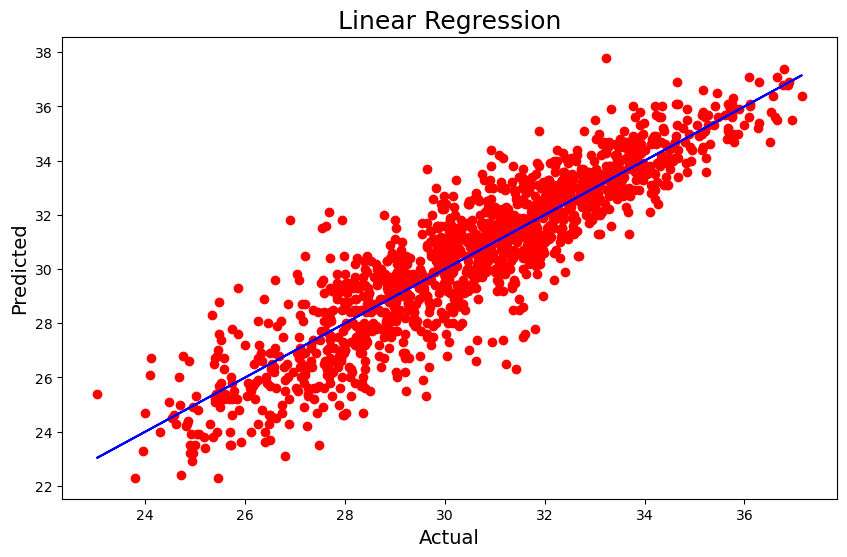

In [70]:
plt.figure(figsize=(10,6))
plt.scatter(x=pred_LR,y=y_test,color='r')
plt.plot(pred_LR,pred_LR,color='b')
plt.xlabel('Actual',fontsize=14)
plt.ylabel('Predicted', fontsize=14)
plt.title('Linear Regression', fontsize=18)
plt.show()

In [71]:
RFR=RandomForestRegressor()
RFR.fit(x_train,y_train)
pred_RFR=RFR.predict(x_test)
pred_train=RFR.predict(x_train)
print('R2_score:',r2_score(y_test,pred_RFR))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('Mean Absolute Error:-',mean_absolute_error(y_test, pred_RFR))
print('Mean Squared Error:-',mean_squared_error(y_test, pred_RFR))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y_test, pred_RFR)))
score1 = cross_val_score(RFR,X_scaler,y)
print(score1)
print(score1.mean())
print('Difference between R2 score and cross validation score is – ', (r2_score(y_test,pred_RFR) - score1.mean())*100)

R2_score: 0.9139211068004718
R2_score on training Data: 98.48769558261714
Mean Absolute Error:- 0.6532099406528192
Mean Squared Error:- 0.7686691906528192
Root Mean Squared Error:- 0.8767378118073951
[0.7362     0.66633312 0.67576765 0.72528484 0.61031703]
0.6827805275512498
Difference between R2 score and cross validation score is –  23.114057924922193


In [72]:
knn=KNN()
knn.fit(x_train,y_train)
pred_knn=knn.predict(x_test)
pred_train=knn.predict(x_train)
print('R2_score:',r2_score(y_test,pred_knn))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('Mean Absolute Error:-',mean_absolute_error(y_test, pred_knn))
print('Mean Squared Error:-',mean_squared_error(y_test, pred_knn))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y_test, pred_knn)))
score2 = cross_val_score(knn,X_scaler,y)
print(score2)
print(score2.mean())
print('Difference between R2 score and cross validation score is =', (r2_score(y_test,pred_knn) - score2.mean())*100)

R2_score: 0.8882635452838653
R2_score on training Data: 91.35384325380048
Mean Absolute Error:- 0.7468991097922848
Mean Squared Error:- 0.9977866468842731
Root Mean Squared Error:- 0.9988927103970041
[0.58894619 0.45073503 0.51616957 0.61217598 0.51238065]
0.5360814844750379
Difference between R2 score and cross validation score is = 35.218206080882744


In [73]:
GBR=GradientBoostingRegressor()
GBR.fit(x_train,y_train)
pred_GBR=GBR.predict(x_test)
pred_train=GBR.predict(x_train)
print('R2_score:',r2_score(y_test,pred_GBR))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('Mean Absolute Error:-',mean_absolute_error(y_test, pred_GBR))
print('Mean Squared Error:-',mean_squared_error(y_test, pred_GBR))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y_test, pred_GBR)))
score3 = cross_val_score(GBR,X_scaler,y)
print(score3)
print(score3.mean())
print('Difference between R2 score and cross validation score is –', (r2_score(y_test,pred_GBR) - score3.mean())*100)

R2_score: 0.8769937488679838
R2_score on training Data: 87.66129308954386
Mean Absolute Error:- 0.8066445752418495
Mean Squared Error:- 1.0984239223861516
Root Mean Squared Error:- 1.0480572133171697
[0.73848518 0.66348507 0.70953332 0.76462927 0.65171322]
0.7055692096567852
Difference between R2 score and cross validation score is – 17.14245392111986


In [74]:
lasso=Lasso()
lasso.fit(x_train,y_train)
pred_lasso=lasso.predict(x_test)
pred_train=lasso.predict(x_train)
print('R2_score:',r2_score(y_test,pred_lasso))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('Mean Absolute Error:-',mean_absolute_error(y_test, pred_lasso))
print('Mean Squared Error:-',mean_squared_error(y_test, pred_lasso))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y_test, pred_lasso)))
score4 = cross_val_score(lasso,X_scaler,y)
print(score4)
print(score4.mean())
print('Difference between R2 score and cross validation score is – ', (r2_score(y_test,pred_lasso) - score4.mean())*100)

R2_score: 0.5587269506932049
R2_score on training Data: 53.93989495882303
Mean Absolute Error:- 1.5853962611936927
Mean Squared Error:- 3.9404897653750868
Root Mean Squared Error:- 1.9850666904099437
[0.4929044  0.47299483 0.56854171 0.42079738 0.52789789]
0.49662724035376893
Difference between R2 score and cross validation score is –  6.209971033943596


In [75]:
rd=Ridge()
rd.fit(x_train,y_train)
pred_rd=rd.predict(x_test)
pred_train=rd.predict(x_train)
print('R2_score:',r2_score(y_test,pred_rd))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('Mean Absolute Error:-',mean_absolute_error(y_test, pred_rd))
print('Mean Squared Error:-',mean_squared_error(y_test, pred_rd))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y_test, pred_rd)))
score5 = cross_val_score(rd,X_scaler,y)
print(score5)
print(score5.mean())
print('Difference between R2 score and cross validation score is – ', (r2_score(y_test,pred_rd) - score5.mean())*100)

R2_score: 0.8113563587338112
R2_score on training Data: 77.89246875251027
Mean Absolute Error:- 0.9992231954947579
Mean Squared Error:- 1.684554130102093
Root Mean Squared Error:- 1.2979037445442914
[0.73482251 0.67984367 0.70048943 0.76533071 0.57900853]
0.6918989720626
Difference between R2 score and cross validation score is –  11.94573866712112


In [76]:
dt= DecisionTreeRegressor()
dt.fit(x_train,y_train)
pred_dt=dt.predict(x_test)
pred_train=dt.predict(x_train)
print('R2_score:',r2_score(y_test,pred_dt))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('Mean Absolute Error:-',mean_absolute_error(y_test, pred_dt))
print('Mean Squared Error:-',mean_squared_error(y_test, pred_dt))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y_test, pred_dt)))
score6 = cross_val_score(dt,X_scaler,y)
print(score6)
print(score6.mean())
print('Difference between R2 score and cross validation score is – ', (r2_score(y_test,pred_dt) - score6.mean())*100)

R2_score: 0.792433582002758
R2_score on training Data: 100.0
Mean Absolute Error:- 0.9581602373887241
Mean Squared Error:- 1.85353115727003
Root Mean Squared Error:- 1.361444511271036
[0.46540506 0.45490459 0.34976025 0.57337409 0.38572679]
0.44583415607747057
Difference between R2 score and cross validation score is –  34.65994259252875


In [77]:
svr= SVR()
svr.fit(x_train,y_train)
pred_svr=svr.predict(x_test)
pred_train=svr.predict(x_train)
print('R2_score:',r2_score(y_test,pred_svr))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('Mean Absolute Error:-',mean_absolute_error(y_test, pred_svr))
print('Mean Squared Error:-',mean_squared_error(y_test, pred_svr))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y_test, pred_svr)))
score7 = cross_val_score(svr,X_scaler,y)
print(score7)
print(score7.mean())
print('Difference between R2 score and cross validation score is – ', (r2_score(y_test,pred_svr) - score7.mean())*100)

R2_score: 0.9086051697266413
R2_score on training Data: 90.73461874672401
Mean Absolute Error:- 0.6664680466418915
Mean Squared Error:- 0.8161395622644864
Root Mean Squared Error:- 0.9034044289599683
[0.75281712 0.58616657 0.70333424 0.78647191 0.58580351]
0.6829186728377382
Difference between R2 score and cross validation score is –  22.568649688890307


In [78]:
etr=ExtraTreesRegressor()
etr.fit(x_train,y_train)
pred_etr=etr.predict(x_test)
pred_train=etr.predict(x_train)
print('R2_score:',r2_score(y_test,pred_etr))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print('Mean Absolute Error:-',mean_absolute_error(y_test, pred_etr))
print('Mean Squared Error:-',mean_squared_error(y_test, pred_etr))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y_test, pred_etr)))
score8 = cross_val_score(etr,X_scaler,y)
print(score8)
print(score8.mean())
print('Difference between R2 score and cross validation score is – ', (r2_score(y_test,pred_etr) - score8.mean())*100)

R2_score: 0.9351616634821472
R2_score on training Data: 100.0
Mean Absolute Error:- 0.5764080118694362
Mean Squared Error:- 0.5789948011869439
Root Mean Squared Error:- 0.7609170790480024
[0.731502   0.65248419 0.71214819 0.76387508 0.5898688 ]
0.6899756520794772
Difference between R2 score and cross validation score is –  24.518601140267005


In [79]:
model = [('Linear Regression', r2_score(y_test,pred_LR),np.sqrt(mean_squared_error(y_test, pred_LR)),score.mean()),
          ('Random Forest Regressor',r2_score(y_test,pred_RFR),np.sqrt(mean_squared_error(y_test, pred_RFR)),score1.mean()),
          ('KNN',r2_score(y_test,pred_knn),np.sqrt(mean_squared_error(y_test, pred_knn)),score2.mean()),
          ('GradientBoostingRegressor',r2_score(y_test,pred_GBR),np.sqrt(mean_squared_error(y_test, pred_GBR)),score3.mean()),
         ('Lasso',r2_score(y_test,pred_lasso),np.sqrt(mean_squared_error(y_test, pred_lasso)),score4.mean()),
         ('Ridge',r2_score(y_test,pred_rd),np.sqrt(mean_squared_error(y_test, pred_rd)),score5.mean()),
         ('DecisionTreeRegressor',r2_score(y_test,pred_dt),np.sqrt(mean_squared_error(y_test, pred_dt)),score6.mean()),
         ('SVR',r2_score(y_test,pred_svr),np.sqrt(mean_squared_error(y_test, pred_svr)),score7.mean()),
         ('ExtraTreesRegressor',r2_score(y_test,pred_etr),np.sqrt(mean_squared_error(y_test, pred_etr)),score8.mean())
        ]

In [80]:
Model = pd.DataFrame(data = model, columns=['Model','R2_Score(test)','RMSE', 'Cross-Validation'])
Model

,Model,R2_Score(test),RMSE,Cross-Validation
0,Linear Regression,0.811356,1.297905,0.691852
1,Random Forest Regressor,0.913921,0.876738,0.682781
2,KNN,0.888264,0.998893,0.536081
3,GradientBoostingRegressor,0.876994,1.048057,0.705569
4,Lasso,0.558727,1.985067,0.496627
5,Ridge,0.811356,1.297904,0.691899
6,DecisionTreeRegressor,0.792434,1.361445,0.445834
7,SVR,0.908605,0.903404,0.682919
8,ExtraTreesRegressor,0.935162,0.760917,0.689976


### Hense from the above, we have got the best score using ExtraTreesRegressor we got score of 93.52%

# Hyper Parameter Tuning :

In [94]:
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint
etr=ExtraTreesRegressor(random_state=84)
# Define the parameter distribution
parameters = {
    'n_estimators': randint(100, 300),
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': randint(2, 10),
    'min_samples_leaf': randint(1, 5),
    'max_features': ['auto', 'sqrt', 'log2']
}
# Perform Randomized Search with cross-validation
random_search = RandomizedSearchCV(estimator=etr, param_distributions=parameters, cv=3, n_jobs=-1,verbose=2)

In [95]:
random_search.fit(x_train, y_train)

Fitting 3 folds for each of 10 candidates, totalling 30 fits


RandomizedSearchCV(cv=3, estimator=ExtraTreesRegressor(random_state=84),
                   n_jobs=-1,
                   param_distributions={'max_depth': [None, 10, 20, 30],
                                        'max_features': ['auto', 'sqrt',
                                                         'log2'],
                                        'min_samples_leaf': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x00000153FE248650>,
                                        'min_samples_split': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x00000153FE24B2D0>,
                                        'n_estimators': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x00000153FE247390>},
                   verbose=2)

In [97]:
# Get the best estimator
best_model = random_search.best_estimator_

In [98]:
best_model

ExtraTreesRegressor(max_depth=20, max_features='auto', min_samples_split=8,
                    n_estimators=217, random_state=84)

In [99]:
Model=ExtraTreesRegressor(max_depth=20, max_features='auto', min_samples_split=8,
                    n_estimators=217, random_state=84)
Model.fit(x_train,y_train)
pred=Model.predict(x_test)
print('R2_score:',r2_score(y_test,pred))
print('Mean Absolute Error:-',mean_absolute_error(y_test, pred))
print('Mean Squared Error:-',mean_squared_error(y_test, pred))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y_test, pred)))

R2_score: 0.9326606818965267
Mean Absolute Error:- 0.5825028800434413
Mean Squared Error:- 0.6013281214679145
Root Mean Squared Error:- 0.7754534940716397


# Saving the model

In [100]:
import joblib
joblib.dump(random_search.best_estimator_,"Temperature_Next_Tmax.obj")

['Temperature_Next_Tmax.obj']

In [101]:
Model=joblib.load('Temperature_Next_Tmax.obj')
Predicted = Model.predict(x_test)
Predicted

array([32.78516151, 32.34547174, 32.99225945, ..., 30.4346938 ,
       28.16166338, 31.45938935])

In [103]:
pd.set_option("display.max_rows", None, "display.max_columns", None)
pd.DataFrame([Model.predict(x_test)[:],y_test[:]],index=["Predicted","Original"])

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

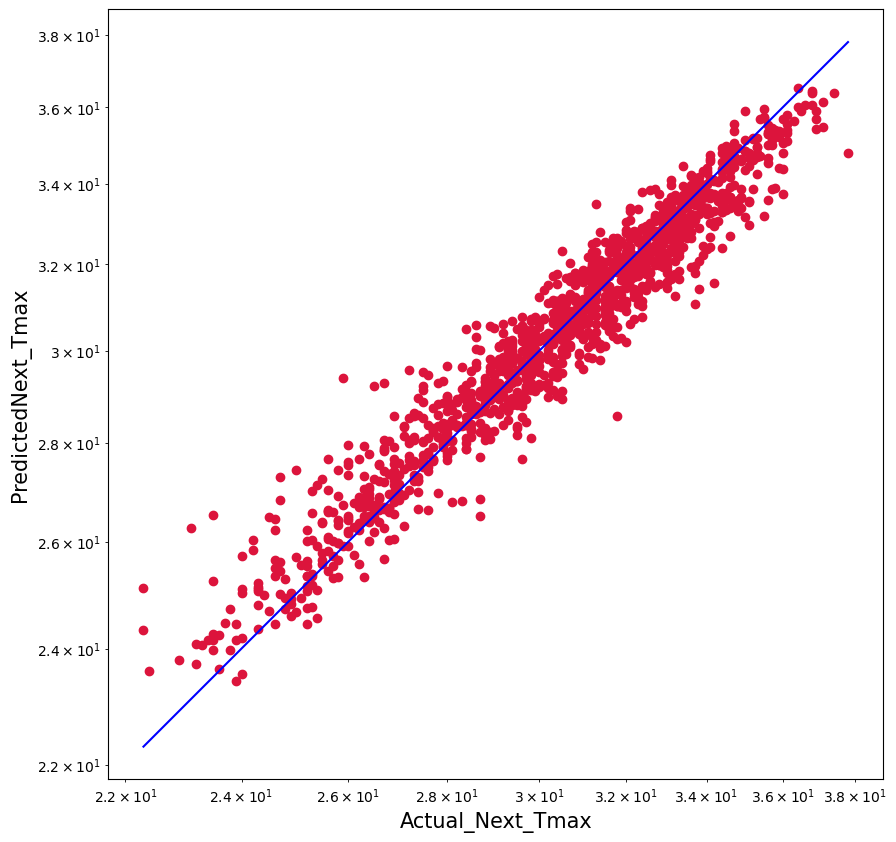

In [106]:
plt.figure(figsize=(10,10))
plt.scatter(y_test, Predicted, c='crimson')
plt.yscale('log')
plt.xscale('log')
p1 = max(max(Predicted), max(y_test))
p2 = min(min(Predicted), min(y_test))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel('Actual_Next_Tmax', fontsize=15)
plt.ylabel('PredictedNext_Tmax', fontsize=15)
plt.axis('equal')
plt.show()

# We have almost reached the accuracy of the Model using Extra Tree Regressor

# Modelling or Model Building and Cross_valuation Score

### For target Next_Tmin

In [110]:
df_nmin

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,Month,Year
0,1.0,28.7,21.4,58.255688,0.348222,28.074101,23.006936,0.176871,0.349992,-0.307447,-0.425528,-0.460839,-0.512476,-0.525370,-0.484794,-0.461889,-0.414444,37.6046,126.991,1.854393,1.327776,1.891687,29.1,21.2,-0.575810,2013
1,2.0,31.9,21.6,52.263397,0.261118,29.850689,24.035009,-0.574617,-0.166810,-0.348674,-0.192022,-0.474101,-0.532674,-0.525370,-0.484794,-0.461889,-0.414444,37.6046,127.032,0.069704,-0.375858,1.431077,30.5,22.5,-0.575810,2013
2,3.0,31.6,23.3,48.690479,-0.717348,30.091292,24.565633,-0.252083,-1.378337,-0.429256,-0.165290,-0.222547,-0.443077,-0.525370,-0.484794,-0.461889,-0.414444,37.5776,127.058,-0.353433,-0.944115,1.410511,31.1,23.9,-0.575810,2013
3,4.0,32.0,23.4,58.239788,1.375094,29.704629,23.326177,-0.606795,0.245926,-0.393954,-0.315683,-0.464009,-0.491694,-0.525370,-0.484794,-0.461889,-0.414444,37.6450,127.022,0.098766,1.249133,1.387059,31.7,24.3,-0.575810,2013
4,5.0,31.4,21.9,56.174095,0.186035,29.113934,23.486480,-0.541825,1.298111,-0.736780,-0.200399,-0.361649,-0.278264,-0.525370,-0.484794,-0.461889,-0.414444,37.5507,127.135,-0.278815,-0.392364,1.396254,31.2,22.5,-0.575810,2013
5,6.0,31.9,23.5,52.437126,-0.541726,29.219342,23.822613,-0.222153,-0.221397,-0.553319,-0.057971,-0.072324,-0.417309,-0.525370,-0.484794,-0.461889,-0.414444,37.5102,127.042,0.338766,-1.310953,1.447094,31.5,24.0,-0.575810,2013
6,7.0,31.4,24.4,56.287189,-1.071959,28.551859,24.238467,-0.655860,1.665689,0.362668,0.172098,0.111527,-0.421290,-0.525370,-0.484794,-0.461889,-0.414444,37.5776,126.838,-1.987461,-1.477226,1.359679,30.9,23.4,-0.575810,2013
7,8.0,32.1,23.6,52.326218,-1.388763,28.851982,23.819054,-0.275263,-0.497947,0.238547,0.219522,0.120791,-0.432614,-0.525370,-0.484794,-0.461889,-0.414444,37.4697,126.910,0.286375,0.793852,1.412067,31.1,22.9,-0.575810,2013
8,9.0,31.4,22.0,55.338791,-1.098251,28.426975,23.332373,-0.336016,0.760392,0.434882,0.218992,0.085743,-0.401944,-0.525370,-0.484794,-0.461889,-0.414444,37.4967,126.826,0.245417,-0.584000,1.458308,31.3,21.6,-0.575810,2013
9,10.0,31.6,20.5,56.651203,-0.325834,27.576705,22.527018,-0.003801,0.168079,0.199998,0.055038,-0.010085,-0.484258,-0.525370,-0.484794,-0.461889,-0.414444,37.4562,126.955,1.837368,1.753201,1.518735,30.5,21.0,-0.575810,2013


In [121]:
x1=df_nmin.drop("Next_Tmin",axis=1)
y1=df_nmin["Next_Tmin"]

In [122]:
x1

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Month,Year
0,1.0,28.7,21.4,58.255688,0.348222,28.074101,23.006936,0.176871,0.349992,-0.307447,-0.425528,-0.460839,-0.512476,-0.525370,-0.484794,-0.461889,-0.414444,37.6046,126.991,1.854393,1.327776,1.891687,29.1,-0.575810,2013
1,2.0,31.9,21.6,52.263397,0.261118,29.850689,24.035009,-0.574617,-0.166810,-0.348674,-0.192022,-0.474101,-0.532674,-0.525370,-0.484794,-0.461889,-0.414444,37.6046,127.032,0.069704,-0.375858,1.431077,30.5,-0.575810,2013
2,3.0,31.6,23.3,48.690479,-0.717348,30.091292,24.565633,-0.252083,-1.378337,-0.429256,-0.165290,-0.222547,-0.443077,-0.525370,-0.484794,-0.461889,-0.414444,37.5776,127.058,-0.353433,-0.944115,1.410511,31.1,-0.575810,2013
3,4.0,32.0,23.4,58.239788,1.375094,29.704629,23.326177,-0.606795,0.245926,-0.393954,-0.315683,-0.464009,-0.491694,-0.525370,-0.484794,-0.461889,-0.414444,37.6450,127.022,0.098766,1.249133,1.387059,31.7,-0.575810,2013
4,5.0,31.4,21.9,56.174095,0.186035,29.113934,23.486480,-0.541825,1.298111,-0.736780,-0.200399,-0.361649,-0.278264,-0.525370,-0.484794,-0.461889,-0.414444,37.5507,127.135,-0.278815,-0.392364,1.396254,31.2,-0.575810,2013
5,6.0,31.9,23.5,52.437126,-0.541726,29.219342,23.822613,-0.222153,-0.221397,-0.553319,-0.057971,-0.072324,-0.417309,-0.525370,-0.484794,-0.461889,-0.414444,37.5102,127.042,0.338766,-1.310953,1.447094,31.5,-0.575810,2013
6,7.0,31.4,24.4,56.287189,-1.071959,28.551859,24.238467,-0.655860,1.665689,0.362668,0.172098,0.111527,-0.421290,-0.525370,-0.484794,-0.461889,-0.414444,37.5776,126.838,-1.987461,-1.477226,1.359679,30.9,-0.575810,2013
7,8.0,32.1,23.6,52.326218,-1.388763,28.851982,23.819054,-0.275263,-0.497947,0.238547,0.219522,0.120791,-0.432614,-0.525370,-0.484794,-0.461889,-0.414444,37.4697,126.910,0.286375,0.793852,1.412067,31.1,-0.575810,2013
8,9.0,31.4,22.0,55.338791,-1.098251,28.426975,23.332373,-0.336016,0.760392,0.434882,0.218992,0.085743,-0.401944,-0.525370,-0.484794,-0.461889,-0.414444,37.4967,126.826,0.245417,-0.584000,1.458308,31.3,-0.575810,2013
9,10.0,31.6,20.5,56.651203,-0.325834,27.576705,22.527018,-0.003801,0.168079,0.199998,0.055038,-0.010085,-0.484258,-0.525370,-0.484794,-0.461889,-0.414444,37.4562,126.955,1.837368,1.753201,1.518735,30.5,-0.575810,2013


In [113]:
df_nmin.shape

(6739, 26)

In [123]:
x1.shape

(6739, 25)

# Feature Scaling (Normalization)

In [124]:
from sklearn.preprocessing import MinMaxScaler
mms=MinMaxScaler()
X= mms.fit_transform(x1)
X.shape

(6739, 25)

In [125]:
y1.value_counts()

23.5    148
24.0    142
23.2    135
23.4    134
23.8    133
23.9    127
23.6    124
23.7    119
22.1    116
24.3    114
23.1    113
22.8    113
23.3    112
22.9    111
24.8    110
24.1    108
23.0    108
22.4    107
22.7    103
24.2    100
22.5     97
24.4     95
24.5     93
24.6     92
21.5     90
24.7     90
22.6     89
21.9     87
22.0     85
20.5     84
24.9     82
20.7     81
21.7     81
22.2     81
25.3     80
21.2     80
21.4     79
21.3     79
20.9     77
25.0     76
25.7     71
21.8     71
21.6     69
25.2     69
22.3     69
25.1     65
26.0     65
20.3     64
25.4     61
20.4     60
26.2     59
21.0     58
20.8     58
21.1     57
20.1     57
20.6     55
26.5     55
25.6     55
25.8     55
20.2     54
26.8     50
25.5     48
26.3     48
26.6     46
26.7     46
26.1     46
27.0     45
20.0     44
19.6     43
26.4     43
25.9     42
19.5     41
19.9     41
26.9     38
19.8     38
19.7     37
19.0     34
19.1     33
27.1     33
27.2     32
27.5     31
19.4     30
19.3     29
19.2

# Multicollinearity

In [126]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
v=variance_inflation_factor
vif=pd.DataFrame()
vif["VIF Values"]=[v(X,i) for i in range(X.shape[1])]
vif["Features"]=x1.columns
vif

,VIF Values,Features
0,4.579847,station
1,29.785087,Present_Tmax
2,33.445754,Present_Tmin
3,44.398306,LDAPS_RHmin
4,15.554441,LDAPS_RHmax
5,78.576126,LDAPS_Tmax_lapse
6,76.751145,LDAPS_Tmin_lapse
7,18.313894,LDAPS_WS
8,55.902957,LDAPS_LH
9,17.186893,LDAPS_CC1


In [127]:
from sklearn.preprocessing import StandardScaler
scalar= StandardScaler()
X_scaled = scalar.fit_transform(x1)
X_scaled.shape

(6739, 25)

In [128]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
v=variance_inflation_factor
vif=pd.DataFrame()
vif["VIF Values"]=[v(X_scaled,i) for i in range(X_scaled.shape[1])]
vif["Features"]=x1.columns
vif

,VIF Values,Features
0,1.303644,station
1,2.906701,Present_Tmax
2,3.132043,Present_Tmin
3,6.008938,LDAPS_RHmin
4,2.593910,LDAPS_RHmax
5,8.209852,LDAPS_Tmax_lapse
6,7.130595,LDAPS_Tmin_lapse
7,1.231810,LDAPS_WS
8,1.535867,LDAPS_LH
9,4.409398,LDAPS_CC1


#### Hense taking X_scaler vales further for Model developement. All vif values are less than 10 heense no multicollinearity exists.

# Modelling or Model Buildingn and Cross_valuation Score 

#### For Target Next_Tmin

In [138]:
maxAccu=0
maxRS=0
for i in range(0,100):
    x1_train,x1_test,y1_train,y1_test = train_test_split(X_scaled,y1,test_size=.20, random_state=i)
    lr=LinearRegression()
    lr.fit(x1_train, y1_train)
    pred = lr.predict(x1_test)
    acc=r2_score(y1_test, pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print('Maximum r2 score is',maxAccu,'on Random_state',maxRS)

Maximum r2 score is 0.854000373679339 on Random_state 70


In [139]:
x1_train,x1_test,y1_train,y1_test = train_test_split(X_scaled,y1,test_size=.20, random_state=70)

In [140]:
print('Size of x_train : ', x1_train.shape)
print('Size of y_train : ', y1_train.shape)
print('Size of x_test : ', x1_test.shape)
print('Size of y_test : ', y1_test.shape)

Size of x_train :  (5391, 25)
Size of y_train :  (5391,)
Size of x_test :  (1348, 25)
Size of y_test :  (1348,)


In [141]:
LR = LinearRegression()
LR.fit(x1_train,y1_train)
pred_LR=LR.predict(x1_test)
pred_train=LR.predict(x1_train)
print('R2_score:',r2_score(y1_test,pred_LR))
print('R2_score on training Data:',r2_score(y1_train,pred_train)*100)
print('Mean Absolute Error:-',mean_absolute_error(y1_test, pred_LR))
print('Mean Squared Error:-',mean_squared_error(y1_test, pred_LR))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y1_test, pred_LR)))
score = cross_val_score(LR,X_scaled,y1, cv=5, scoring='r2')
print(score)
print(score.mean())
print('Difference between R2 score and cross validation score is =', (r2_score(y1_test,pred_LR) - score.mean())*100)

R2_score: 0.854000373679339
R2_score on training Data: 83.63397302344663
Mean Absolute Error:- 0.7296947304556332
Mean Squared Error:- 0.8389772514558489
Root Mean Squared Error:- 0.9159570139781937
[0.74192267 0.68226842 0.80343574 0.86790164 0.86158346]
0.791422384283491
Difference between R2 score and cross validation score is = 6.257798939584802


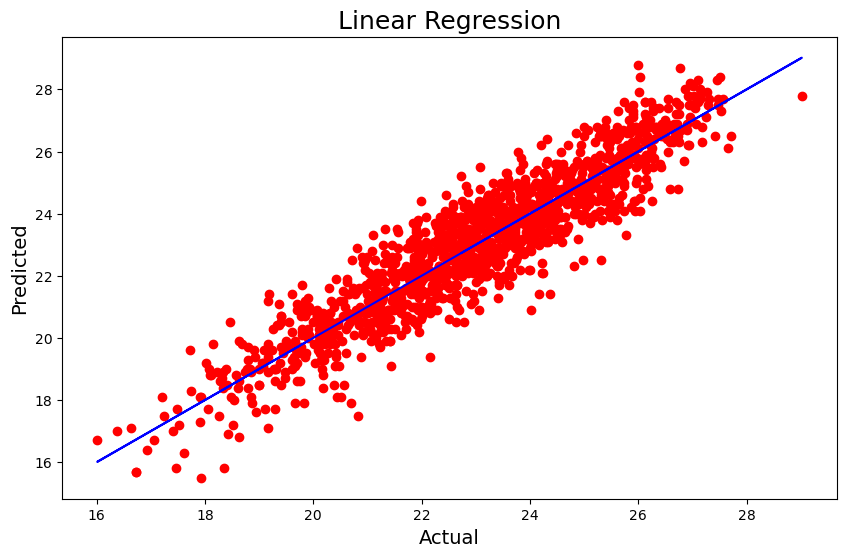

In [142]:
plt.figure(figsize=(10,6))
plt.scatter(x=pred_LR,y=y1_test,color='r')
plt.plot(pred_LR,pred_LR,color='b')
plt.xlabel('Actual',fontsize=14)
plt.ylabel('Predicted', fontsize=14)
plt.title('Linear Regression', fontsize=18)
plt.show()

In [143]:
RFR=RandomForestRegressor()
RFR.fit(x1_train,y1_train)
pred_RFR=RFR.predict(x1_test)
pred_train=RFR.predict(x1_train)
print('R2_score:',r2_score(y1_test,pred_RFR))
print('R2_score on training Data:',r2_score(y1_train,pred_train)*100)
print('Mean Absolute Error:-',mean_absolute_error(y1_test, pred_RFR))
print('Mean Squared Error:-',mean_squared_error(y1_test, pred_RFR))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y1_test, pred_RFR)))
score1 = cross_val_score(RFR,X_scaled,y1)
print(score1)
print(score1.mean())
print('Difference between R2 score and cross validation score is – ', (r2_score(y1_test,pred_RFR) - score1.mean())*100)

R2_score: 0.9120554126465242
R2_score on training Data: 98.65470871997599
Mean Absolute Error:- 0.5441602373887238
Mean Squared Error:- 0.5053677878338274
Root Mean Squared Error:- 0.710892247695688
[0.73282516 0.7014629  0.80885237 0.87603883 0.85428985]
0.7946938233426637
Difference between R2 score and cross validation score is –  11.736158930386054


In [144]:
knn=KNN()
knn.fit(x1_train,y1_train)
pred_knn=knn.predict(x1_test)
pred_train=knn.predict(x1_train)
print('R2_score:',r2_score(y1_test,pred_knn))
print('R2_score on training Data:',r2_score(y1_train,pred_train)*100)
print('Mean Absolute Error:-',mean_absolute_error(y1_test, pred_knn))
print('Mean Squared Error:-',mean_squared_error(y1_test, pred_knn))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y1_test, pred_knn)))
score2 = cross_val_score(knn,X_scaled,y1)
print(score2)
print(score2.mean())
print('Difference between R2 score and cross validation score is =', (r2_score(y1_test,pred_knn) - score2.mean())*100)

R2_score: 0.8690169540382189
R2_score on training Data: 91.95323484927714
Mean Absolute Error:- 0.6707121661721068
Mean Squared Error:- 0.752685459940653
Root Mean Squared Error:- 0.8675744693919093
[0.5078714  0.4748343  0.64156546 0.71154896 0.75817192]
0.618798408664281
Difference between R2 score and cross validation score is = 25.021854537393786


In [145]:
GBR=GradientBoostingRegressor()
GBR.fit(x1_train,y1_train)
pred_GBR=GBR.predict(x1_test)
pred_train=GBR.predict(x1_train)
print('R2_score:',r2_score(y1_test,pred_GBR))
print('R2_score on training Data:',r2_score(y1_train,pred_train)*100)
print('Mean Absolute Error:-',mean_absolute_error(y1_test, pred_GBR))
print('Mean Squared Error:-',mean_squared_error(y1_test, pred_GBR))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y1_test, pred_GBR)))
score3 = cross_val_score(GBR,X_scaled,y1)
print(score3)
print(score3.mean())
print('Difference between R2 score and cross validation score is –', (r2_score(y1_test,pred_GBR) - score3.mean())*100)

R2_score: 0.894272453316538
R2_score on training Data: 90.97626850214715
Mean Absolute Error:- 0.6086432932473379
Mean Squared Error:- 0.6075563941844703
Root Mean Squared Error:- 0.7794590394526644
[0.74110858 0.69849661 0.81929469 0.88148062 0.88543374]
0.8051628473287131
Difference between R2 score and cross validation score is – 8.910960598782491


In [146]:
lasso=Lasso()
lasso.fit(x1_train,y1_train)
pred_lasso=lasso.predict(x1_test)
pred_train=lasso.predict(x1_train)
print('R2_score:',r2_score(y1_test,pred_lasso))
print('R2_score on training Data:',r2_score(y1_train,pred_train)*100)
print('Mean Absolute Error:-',mean_absolute_error(y1_test, pred_lasso))
print('Mean Squared Error:-',mean_squared_error(y1_test, pred_lasso))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y1_test, pred_lasso)))
score4 = cross_val_score(lasso,X_scaled,y1)
print(score4)
print(score4.mean())
print('Difference between R2 score and cross validation score is – ', (r2_score(y_test,pred_lasso) - score4.mean())*100)

R2_score: 0.6026620397935236
R2_score on training Data: 58.49687745035032
Mean Absolute Error:- 1.2178733916003837
Mean Squared Error:- 2.283276458673567
Root Mean Squared Error:- 1.5110514414385656
[0.54779193 0.40887063 0.57999219 0.50019864 0.63086944]
0.5335445672668998
Difference between R2 score and cross validation score is –  6.911747252662382


In [147]:
rd=Ridge()
rd.fit(x1_train,y1_train)
pred_rd=rd.predict(x1_test)
pred_train=rd.predict(x1_train)
print('R2_score:',r2_score(y1_test,pred_rd))
print('R2_score on training Data:',r2_score(y1_train,pred_train)*100)
print('Mean Absolute Error:-',mean_absolute_error(y1_test, pred_rd))
print('Mean Squared Error:-',mean_squared_error(y1_test, pred_rd))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y1_test, pred_rd)))
score5 = cross_val_score(rd,X_scaled,y1)
print(score5)
print(score5.mean())
print('Difference between R2 score and cross validation score is – ', (r2_score(y1_test,pred_rd) - score5.mean())*100)

R2_score: 0.8540006820545772
R2_score on training Data: 83.63396600949254
Mean Absolute Error:- 0.7297055872911113
Mean Squared Error:- 0.8389754793978214
Root Mean Squared Error:- 0.9159560466517055
[0.74194564 0.68234048 0.80340715 0.86791672 0.86160101]
0.7914421987480292
Difference between R2 score and cross validation score is –  6.255848330654801


In [148]:
dt= DecisionTreeRegressor()
dt.fit(x1_train,y1_train)
pred_dt=dt.predict(x1_test)
pred_train=dt.predict(x1_train)
print('R2_score:',r2_score(y1_test,pred_dt))
print('R2_score on training Data:',r2_score(y1_train,pred_train)*100)
print('Mean Absolute Error:-',mean_absolute_error(y1_test, pred_dt))
print('Mean Squared Error:-',mean_squared_error(y1_test, pred_dt))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y1_test, pred_dt)))
score6 = cross_val_score(dt,X_scaled,y1)
print(score6)
print(score6.mean())
print('Difference between R2 score and cross validation score is – ', (r2_score(y1_test,pred_dt) - score6.mean())*100)

R2_score: 0.7984571351589038
R2_score on training Data: 100.0
Mean Absolute Error:- 0.8178783382789317
Mean Squared Error:- 1.1581528189910981
Root Mean Squared Error:- 1.0761750875164775
[0.4798628  0.45823587 0.63087333 0.77883196 0.67182264]
0.6039253223763084
Difference between R2 score and cross validation score is –  19.453181278259546


In [149]:
svr= SVR()
svr.fit(x1_train,y1_train)
pred_svr=svr.predict(x1_test)
pred_train=svr.predict(x1_train)
print('R2_score:',r2_score(y1_test,pred_svr))
print('R2_score on training Data:',r2_score(y1_train,pred_train)*100)
print('Mean Absolute Error:-',mean_absolute_error(y1_test, pred_svr))
print('Mean Squared Error:-',mean_squared_error(y1_test, pred_svr))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y1_test, pred_svr)))
score7 = cross_val_score(svr,X_scaled,y1)
print(score7)
print(score7.mean())
print('Difference between R2 score and cross validation score is – ', (r2_score(y1_test,pred_svr) - score7.mean())*100)

R2_score: 0.9192309384559831
R2_score on training Data: 94.39040911842352
Mean Absolute Error:- 0.5238911009581261
Mean Squared Error:- 0.46413410064514693
Root Mean Squared Error:- 0.6812738807888843
[0.57356248 0.66479233 0.74812682 0.84552525 0.82500002]
0.7314013808218681
Difference between R2 score and cross validation score is –  18.7829557634115


In [150]:
etr=ExtraTreesRegressor()
etr.fit(x1_train,y1_train)
pred_etr=etr.predict(x1_test)
pred_train=etr.predict(x1_train)
print('R2_score:',r2_score(y1_test,pred_etr))
print('R2_score on training Data:',r2_score(y1_train,pred_train)*100)
print('Mean Absolute Error:-',mean_absolute_error(y1_test, pred_etr))
print('Mean Squared Error:-',mean_squared_error(y1_test, pred_etr))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y1_test, pred_etr)))
score8 = cross_val_score(etr,X_scaled,y1)
print(score8)
print(score8.mean())
print('Difference between R2 score and cross validation score is – ', (r2_score(y1_test,pred_etr) - score8.mean())*100)

R2_score: 0.9208682261005727
R2_score on training Data: 100.0
Mean Absolute Error:- 0.5130200296735908
Mean Squared Error:- 0.4547255348664689
Root Mean Squared Error:- 0.6743334003788252
[0.72297231 0.69881411 0.81525395 0.87659332 0.87177018]
0.797080775148686
Difference between R2 score and cross validation score is –  12.37874509518867


In [151]:
model = [('Linear Regression', r2_score(y1_test,pred_LR),np.sqrt(mean_squared_error(y1_test, pred_LR)),score.mean()),
          ('Random Forest Regressor',r2_score(y1_test,pred_RFR),np.sqrt(mean_squared_error(y1_test, pred_RFR)),score1.mean()),
          ('KNN',r2_score(y1_test,pred_knn),np.sqrt(mean_squared_error(y1_test, pred_knn)),score2.mean()),
          ('GradientBoostingRegressor',r2_score(y1_test,pred_GBR),np.sqrt(mean_squared_error(y1_test, pred_GBR)),score3.mean()),
         ('Lasso',r2_score(y1_test,pred_lasso),np.sqrt(mean_squared_error(y1_test, pred_lasso)),score4.mean()),
         ('Ridge',r2_score(y1_test,pred_rd),np.sqrt(mean_squared_error(y1_test, pred_rd)),score5.mean()),
         ('DecisionTreeRegressor',r2_score(y1_test,pred_dt),np.sqrt(mean_squared_error(y1_test, pred_dt)),score6.mean()),
         ('SVR',r2_score(y1_test,pred_svr),np.sqrt(mean_squared_error(y1_test, pred_svr)),score7.mean()),
         ('ExtraTreesRegressor',r2_score(y_test,pred_etr),np.sqrt(mean_squared_error(y_test, pred_etr)),score8.mean())
        ]

In [152]:
Model = pd.DataFrame(data = model, columns=['Model','R2_Score(test)','RMSE', 'Cross-Validation'])
Model

,Model,R2_Score(test),RMSE,Cross-Validation
0,Linear Regression,0.854000,0.915957,0.791422
1,Random Forest Regressor,0.912055,0.710892,0.794694
2,KNN,0.869017,0.867574,0.618798
3,GradientBoostingRegressor,0.894272,0.779459,0.805163
4,Lasso,0.602662,1.511051,0.533545
5,Ridge,0.854001,0.915956,0.791442
6,DecisionTreeRegressor,0.798457,1.076175,0.603925
7,SVR,0.919231,0.681274,0.731401
8,ExtraTreesRegressor,0.920868,0.674333,0.797081


#### For the Target Next_Tmin also the best suitable model is Extra Trees Regressor as the accuracy score is 0.92 and cross validation score 0.797

# Hyper Parameter Tuning

In [153]:
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint
etr=ExtraTreesRegressor(random_state=70)
# Define the parameter distribution
parameters = {
    'n_estimators': randint(100, 300),
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': randint(2, 10),
    'min_samples_leaf': randint(1, 5),
    'max_features': ['auto', 'sqrt', 'log2']
}
# Perform Randomized Search with cross-validation
random_search = RandomizedSearchCV(estimator=etr, param_distributions=parameters, cv=3, n_jobs=-1,verbose=2)

In [156]:
random_search.fit(x1_train, y1_train)

Fitting 3 folds for each of 10 candidates, totalling 30 fits


RandomizedSearchCV(cv=3, estimator=ExtraTreesRegressor(random_state=70),
                   n_jobs=-1,
                   param_distributions={'max_depth': [None, 10, 20, 30],
                                        'max_features': ['auto', 'sqrt',
                                                         'log2'],
                                        'min_samples_leaf': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x00000153FE334A50>,
                                        'min_samples_split': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x00000153E46E4ED0>,
                                        'n_estimators': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x00000153FE2DEF10>},
                   verbose=2)

In [157]:
# Get the best estimator
Final_model = random_search.best_estimator_
Final_model

ExtraTreesRegressor(max_features='auto', min_samples_split=4, n_estimators=271,
                    random_state=70)

In [159]:
model=ExtraTreesRegressor(max_features='auto', min_samples_split=4, n_estimators=271,
                    random_state=70)
model.fit(x1_train,y1_train)
pred=model.predict(x1_test)
print('R2_score:',r2_score(y1_test,pred))
print('Mean Absolute Error:-',mean_absolute_error(y1_test, pred))
print('Mean Squared Error:-',mean_squared_error(y1_test, pred))
print('Root Mean Squared Error:-',np.sqrt(mean_squared_error(y1_test, pred)))

R2_score: 0.9208633250901912
Mean Absolute Error:- 0.5160541698146957
Mean Squared Error:- 0.4547536982003271
Root Mean Squared Error:- 0.6743542824067532


# Saving the Model

In [160]:
import joblib
joblib.dump(random_search.best_estimator_,"Temperature_Next_Tmin.obj")

['Temperature_Next_Tmin.obj']

In [161]:
Model=joblib.load('Temperature_Next_Tmin.obj')
Predicted = Model.predict(x1_test)
Predicted

array([23.17373924, 23.96088561, 26.48825338, ..., 24.96592866,
       19.2400369 , 20.0404059 ])

In [162]:
pd.set_option("display.max_rows", None, "display.max_columns", None)
pd.DataFrame([Model.predict(x1_test)[:],y1_test[:]],index=["Predicted","Original"])

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

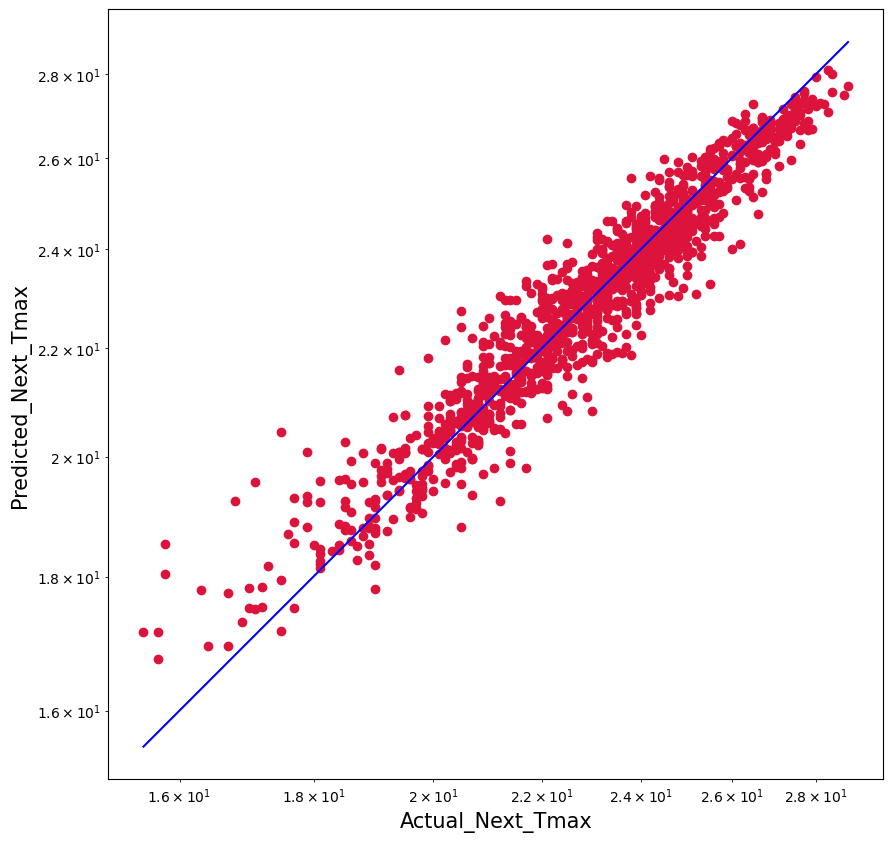

In [164]:
plt.figure(figsize=(10,10))
plt.scatter(y_test, Predicted, c='crimson')
plt.yscale('log')
plt.xscale('log')
P1 = max(max(Predicted), max(y1_test))
P2 = min(min(Predicted), min(y1_test))
plt.plot([P1, P2], [P1, P2], 'b-')
plt.xlabel('Actual_Next_Tmax', fontsize=15)
plt.ylabel('Predicted_Next_Tmax', fontsize=15)
plt.axis('equal')
plt.show()

# We have almost reached the accuracy of the Model using Extra Tree Regressor